In [37]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from getdist import plots, MCSamples
import getdist
import matplotlib.pyplot as plt
import IPython
import numpy as np
import arviz as az
import random

In [13]:
def plot_data(file_name):
    # define parameter names and labels
    names = ["h", "\Omega_b", "\Omega_c", "n_s", "a_s"]
    labels = ["h", "\Omega_b", "\Omega_c", "n_s", "a_s"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("Data/true_parameters_FINAL.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={'h': true_param[0], 
                             "\Omega_b": true_param[1], 
                             "\Omega_c": true_param[2], 
                             "n_s": true_param[3], 
                             "a_s": np.log(true_param[4] * 10**10)})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-3].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-5])
    ndim = int(file_name.split("_")[-6])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i < 4:
            axs[0].axvline(x=true_param[i], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[i] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


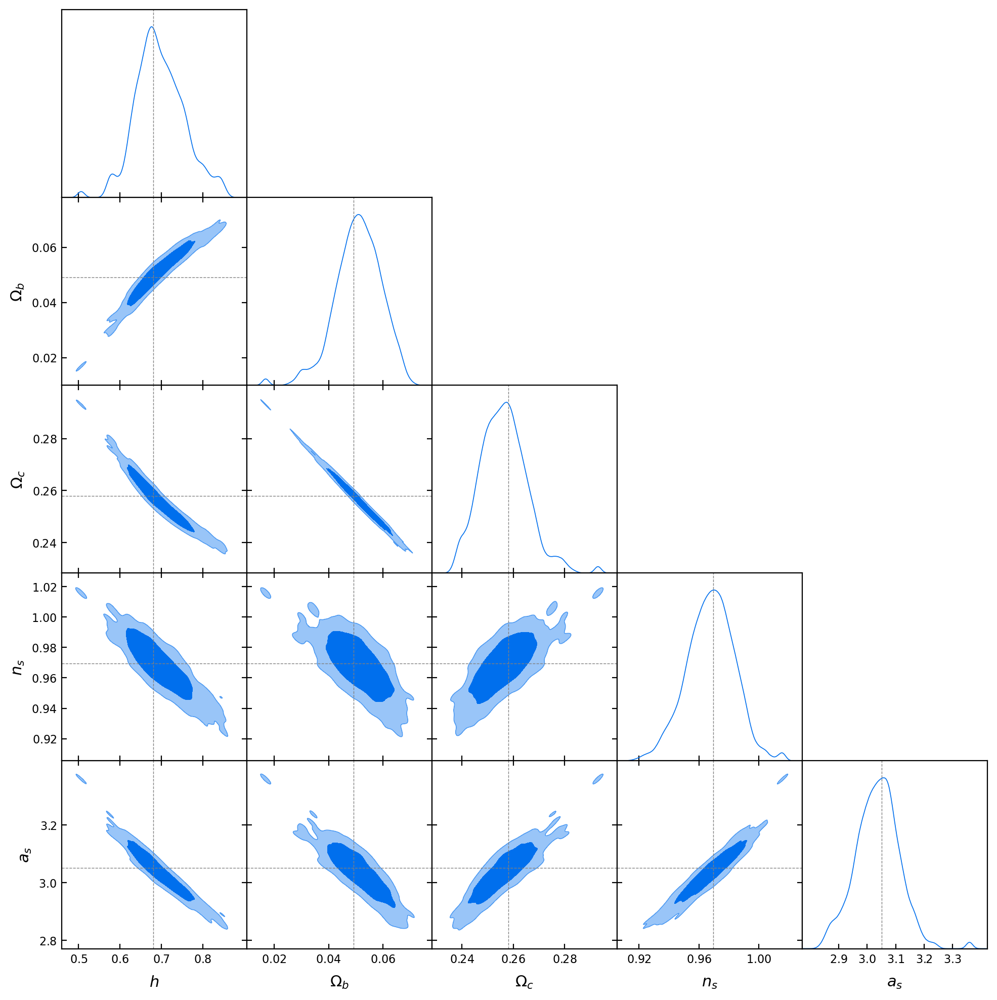

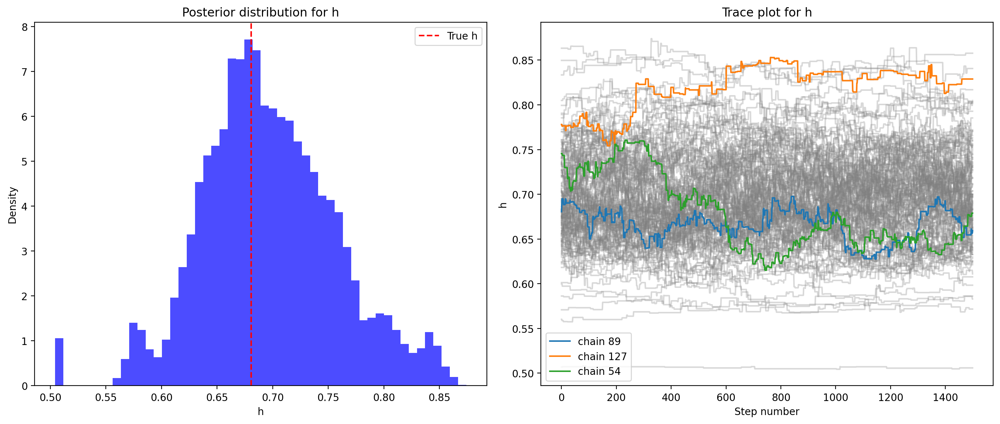

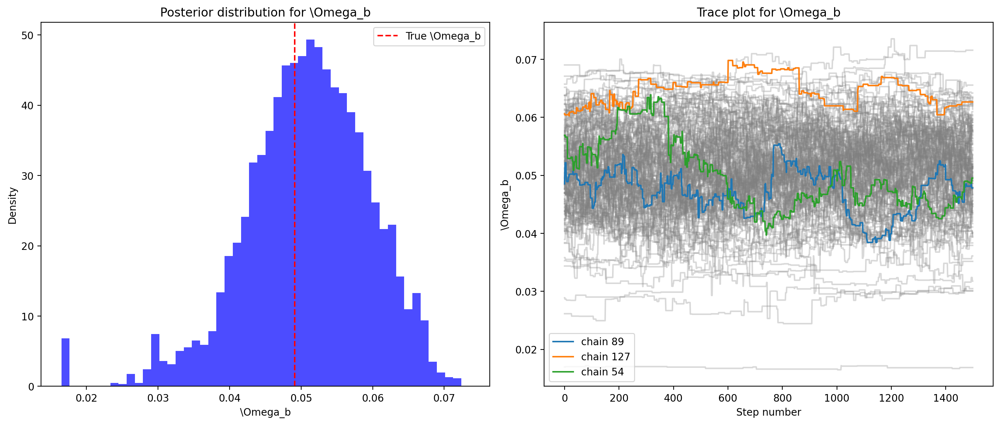

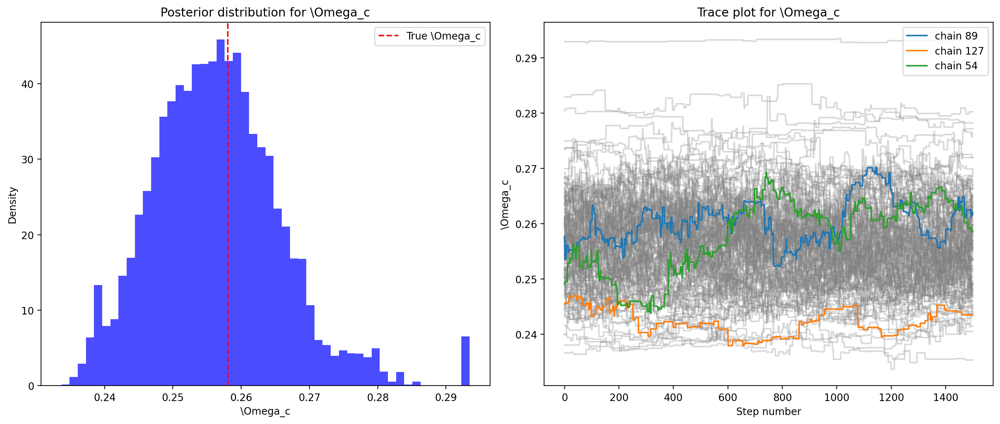

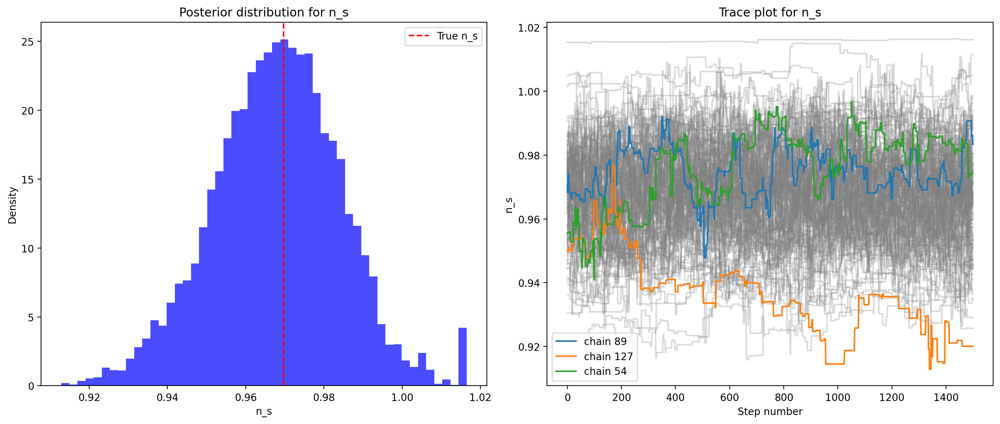

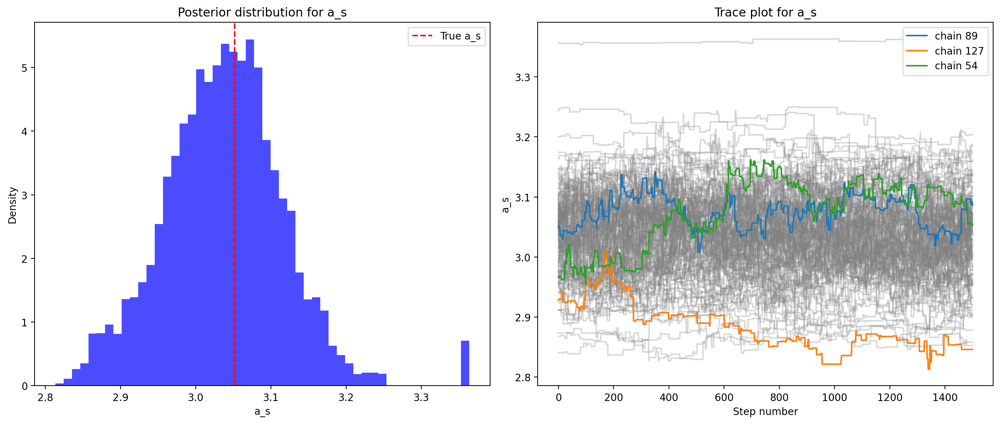

In [5]:
plot_data("chain_results_5_128_2000_2000_run_6.npy")

In [27]:
def plot_data_3_param(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "n_s", "a_s"]
    labels = ["\Omega_c", "n_s", "a_s"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "n_s": true_param[3], 
                             "a_s": np.log(true_param[4] * 10**10)})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-3].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-5])
    ndim = int(file_name.split("_")[-6])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i < 2:
            axs[0].axvline(x=true_param[i + 2], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[i + 2] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


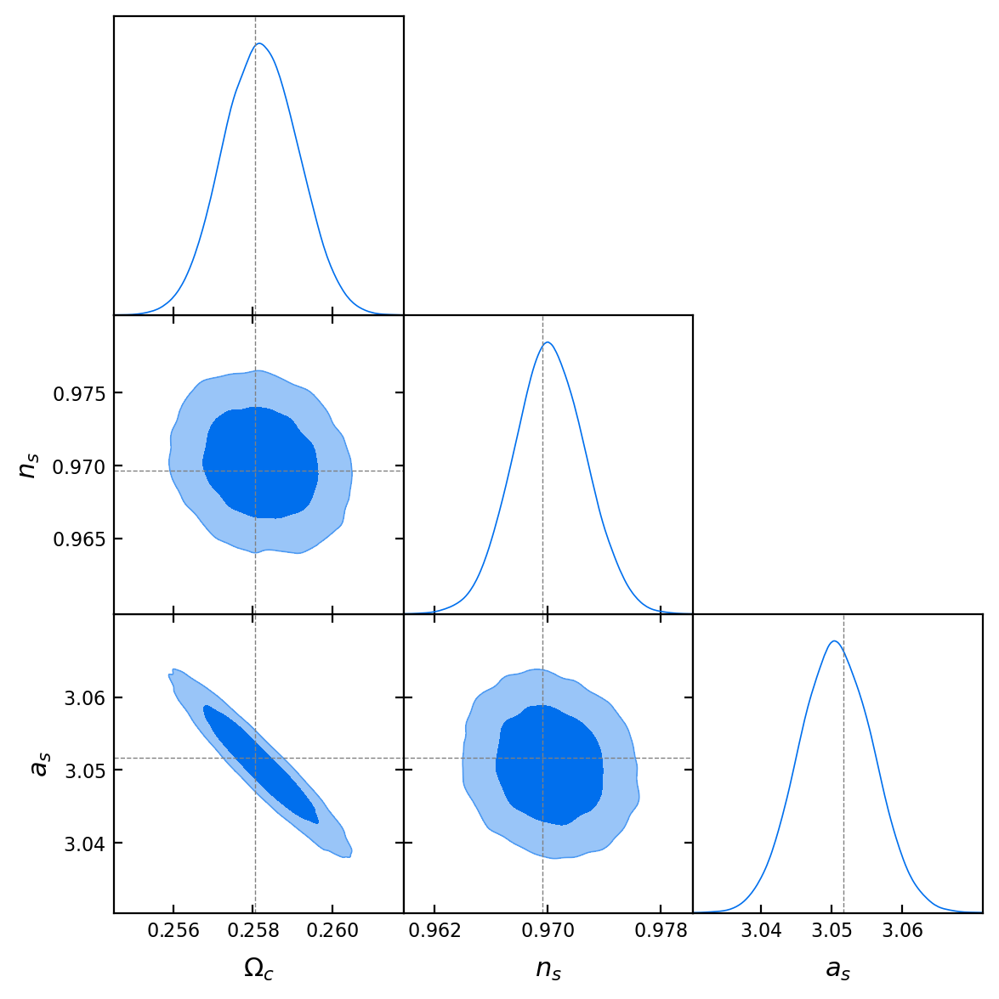

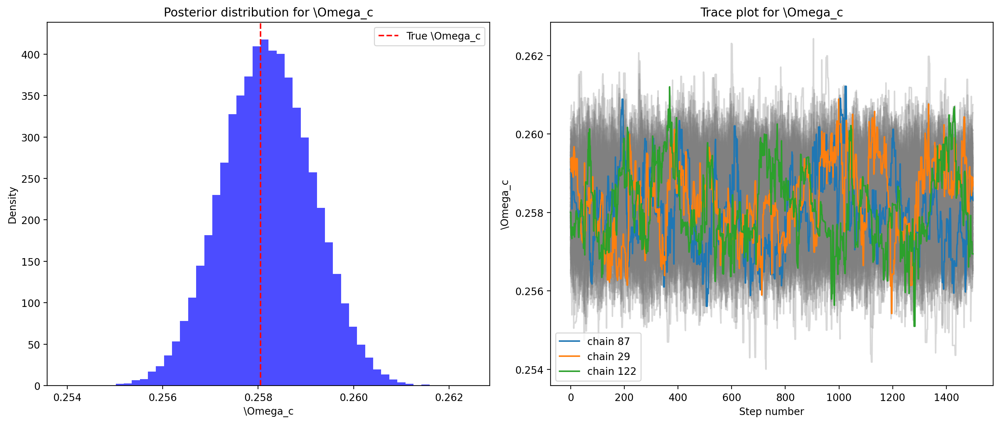

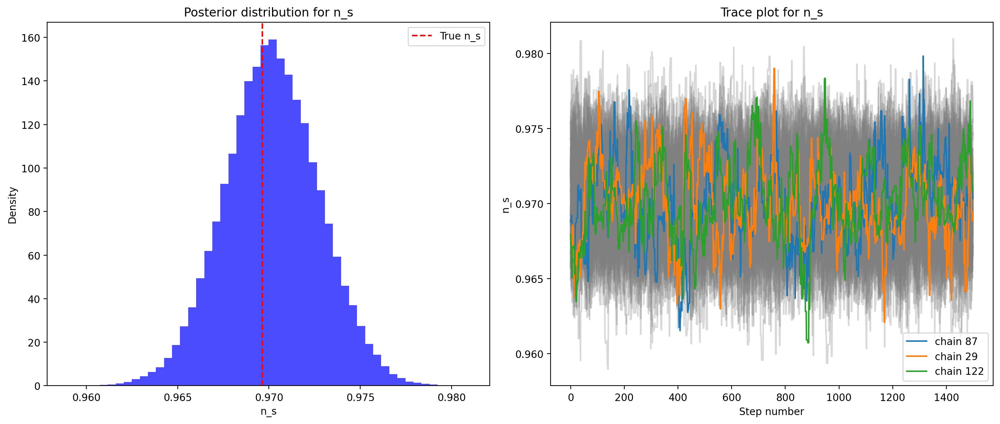

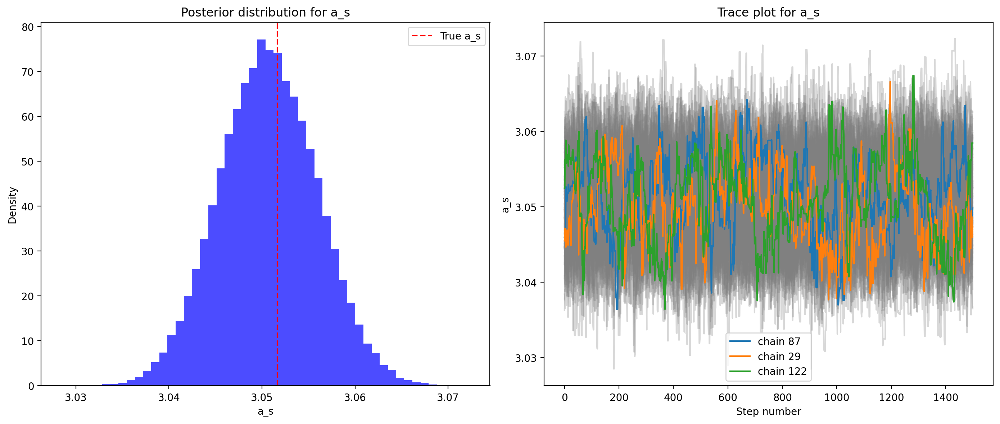

In [13]:
plot_data_3_param("chain_results_3_128_2000_2000_run_2.npy")

In [16]:
def plot_data_2_param(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "a_s"]
    labels = ["\Omega_c", "a_s"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "a_s": np.log(true_param[4] * 10**10)})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-3].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-5])
    ndim = int(file_name.split("_")[-6])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i < 1:
            axs[0].axvline(x=true_param[2], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[4] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


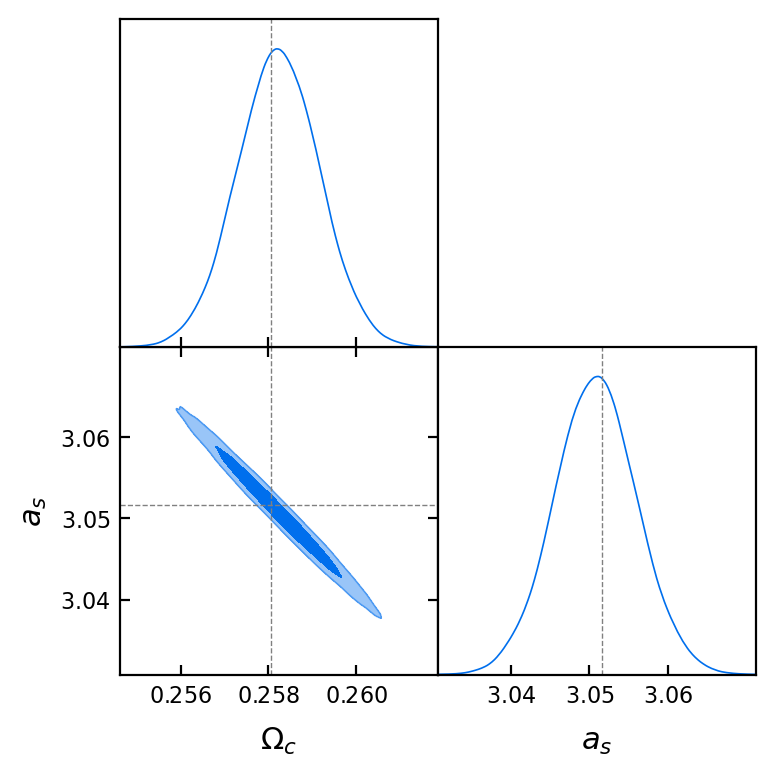

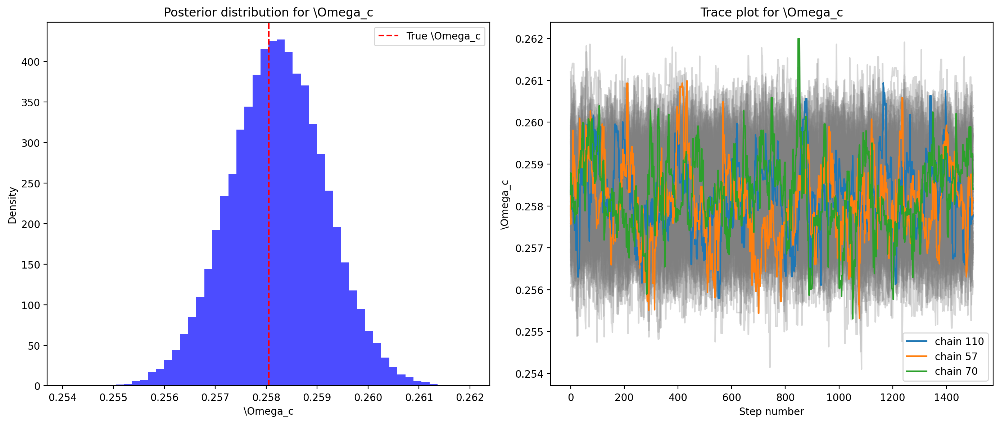

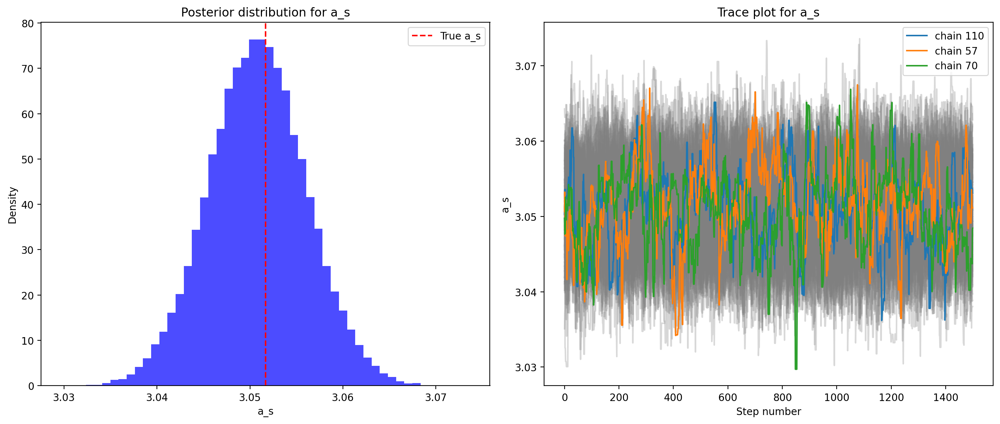

In [18]:
plot_data_2_param("chain_results_2_128_2000_2000_run_1.npy")

In [38]:
def plot_data_3_param_m_nu(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "a_s", "m_nu"]
    labels = ["\Omega_c", "a_s", "m_nu"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters_neutrino_mass.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "a_s": np.log(true_param[4] * 10**10), 
                             "m_nu": true_param[5]})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-5].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-7])
    ndim = int(file_name.split("_")[-8])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i == 0:
            axs[0].axvline(x=true_param[2], color='red', linestyle='--', label=f"True {label}")
        elif i == 2:
            axs[0].axvline(x=true_param[5], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[4] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


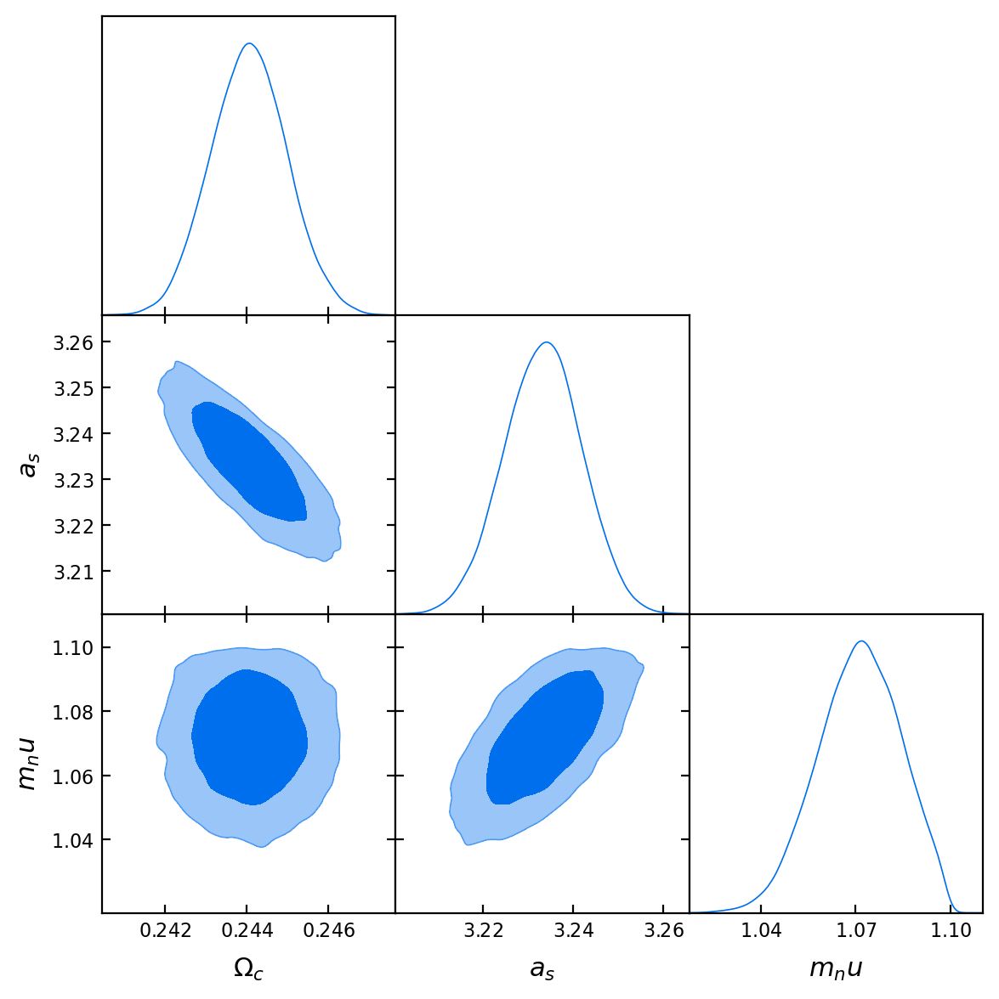

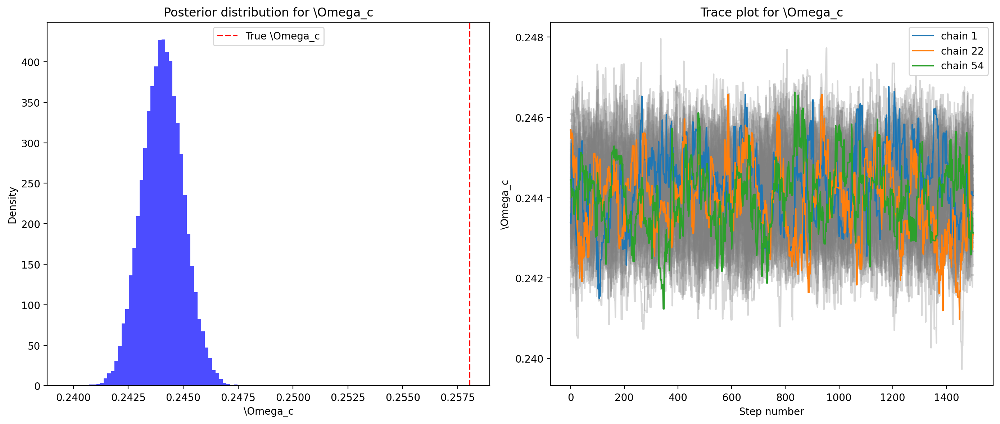

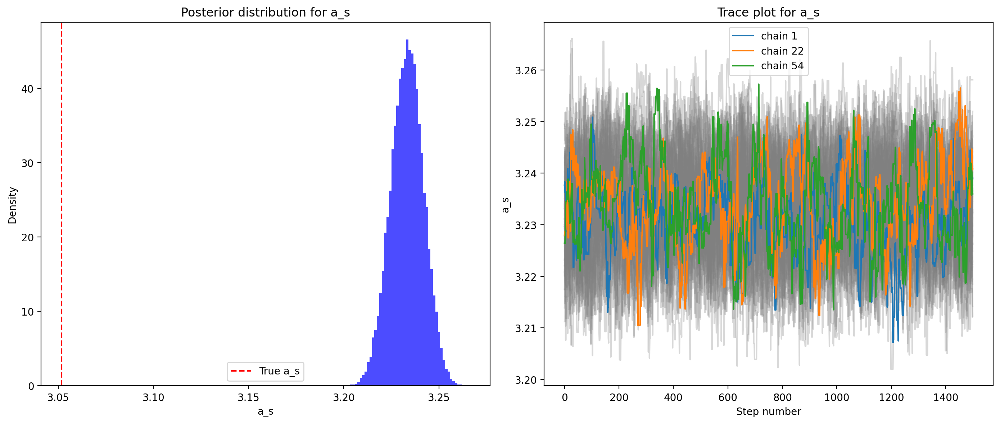

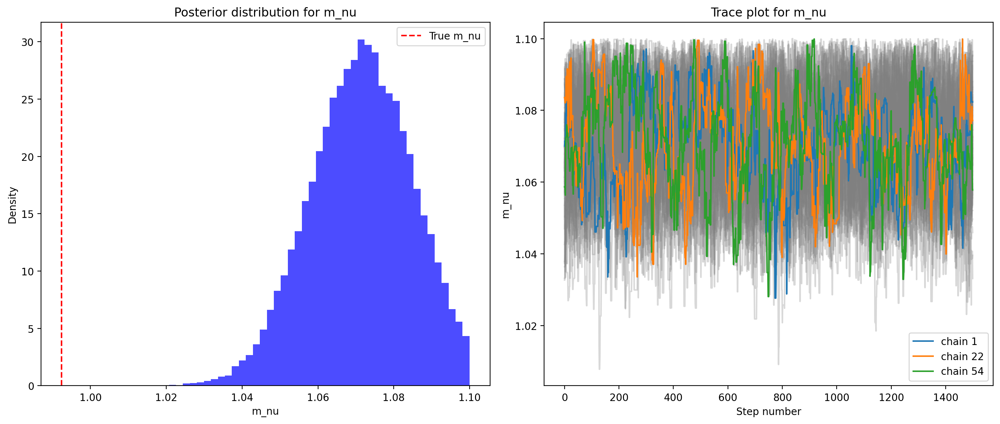

In [28]:
plot_data_3_param_m_nu("chain_results_3_64_2000_2000_m_nu_run_1.npy")

Removed no burn in


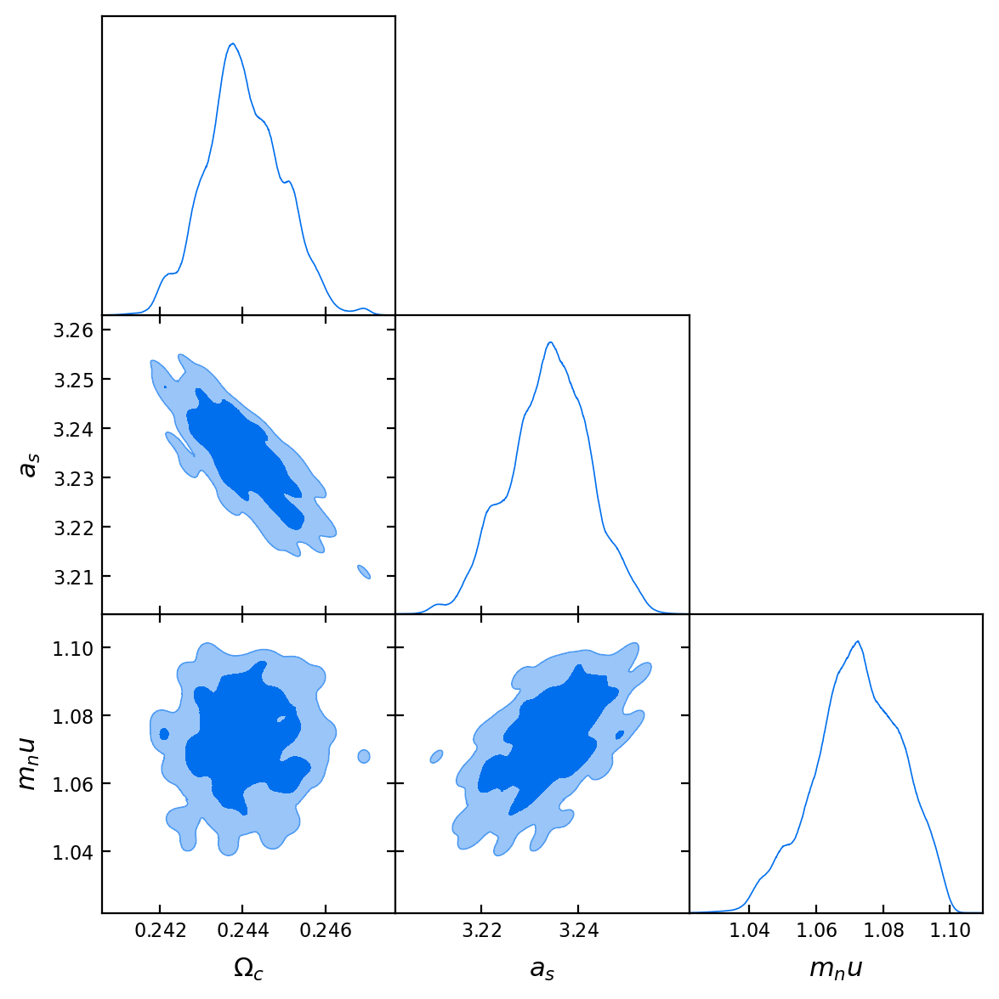

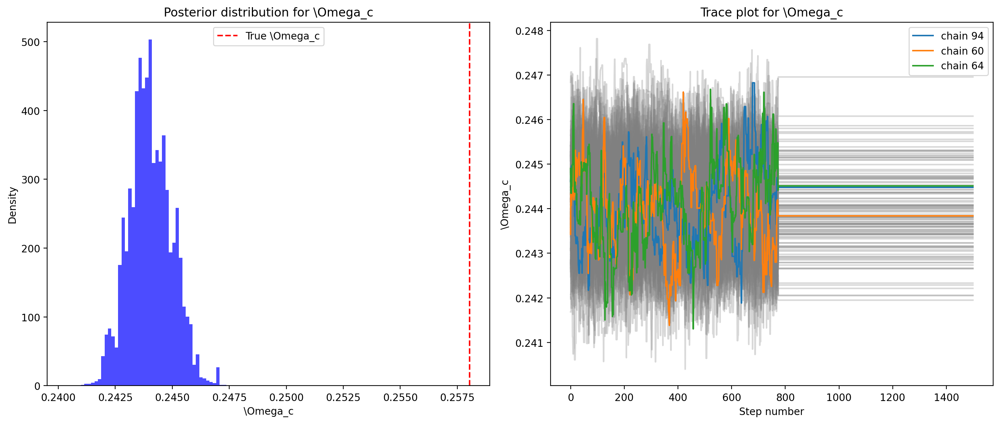

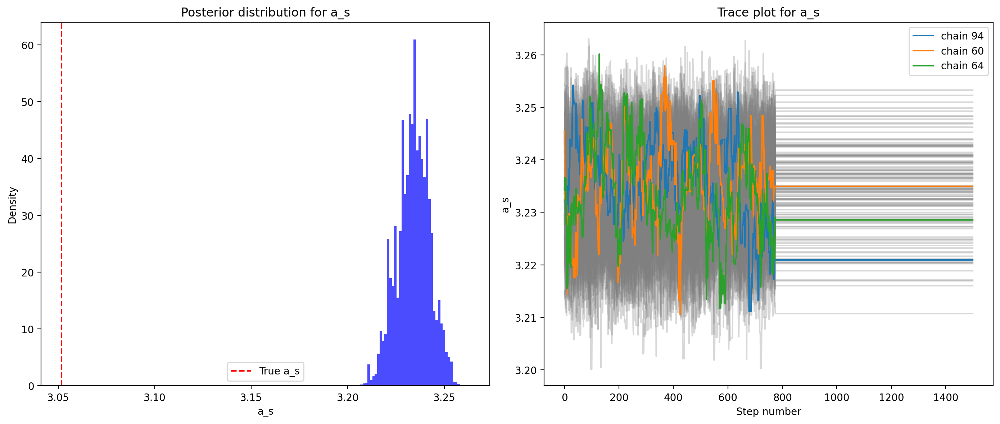

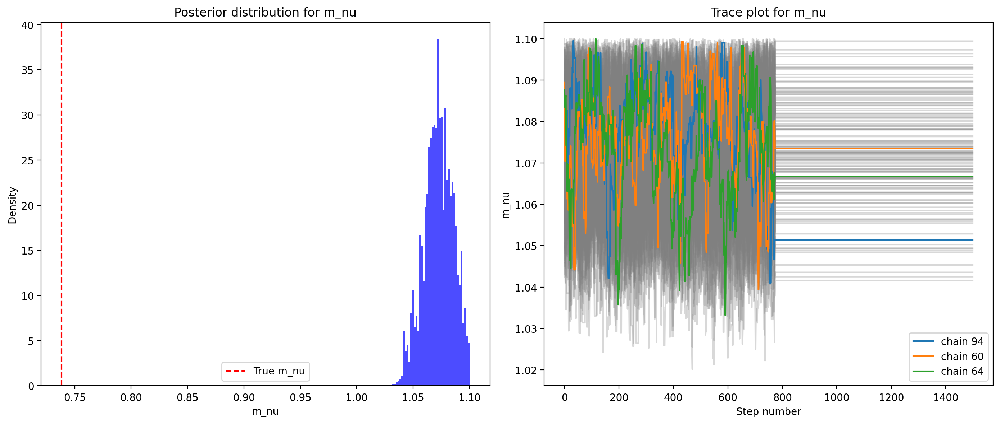

In [6]:
plot_data_3_param_m_nu("chain_results_3_128_2000_2000_m_nu_run_1.npy")

In [32]:
def plot_data_4_param_w0_wa(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "a_s", "w0", "wa"]
    labels = ["\Omega_c", "a_s", "w0", "wa"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters_neutrino_mass_varying_dark_energy.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "a_s": np.log(true_param[4] * 10**10), 
                             "w0": true_param[-2], 
                             "wa": true_param[-1]})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-5].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-7])
    ndim = int(file_name.split("_")[-8])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i == 0:
            axs[0].axvline(x=true_param[2], color='red', linestyle='--', label=f"True {label}")
        elif i == 2:
            axs[0].axvline(x=true_param[6], color='red', linestyle='--', label=f"True {label}")
        elif i == 3:
            axs[0].axvline(x=true_param[7], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[4] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


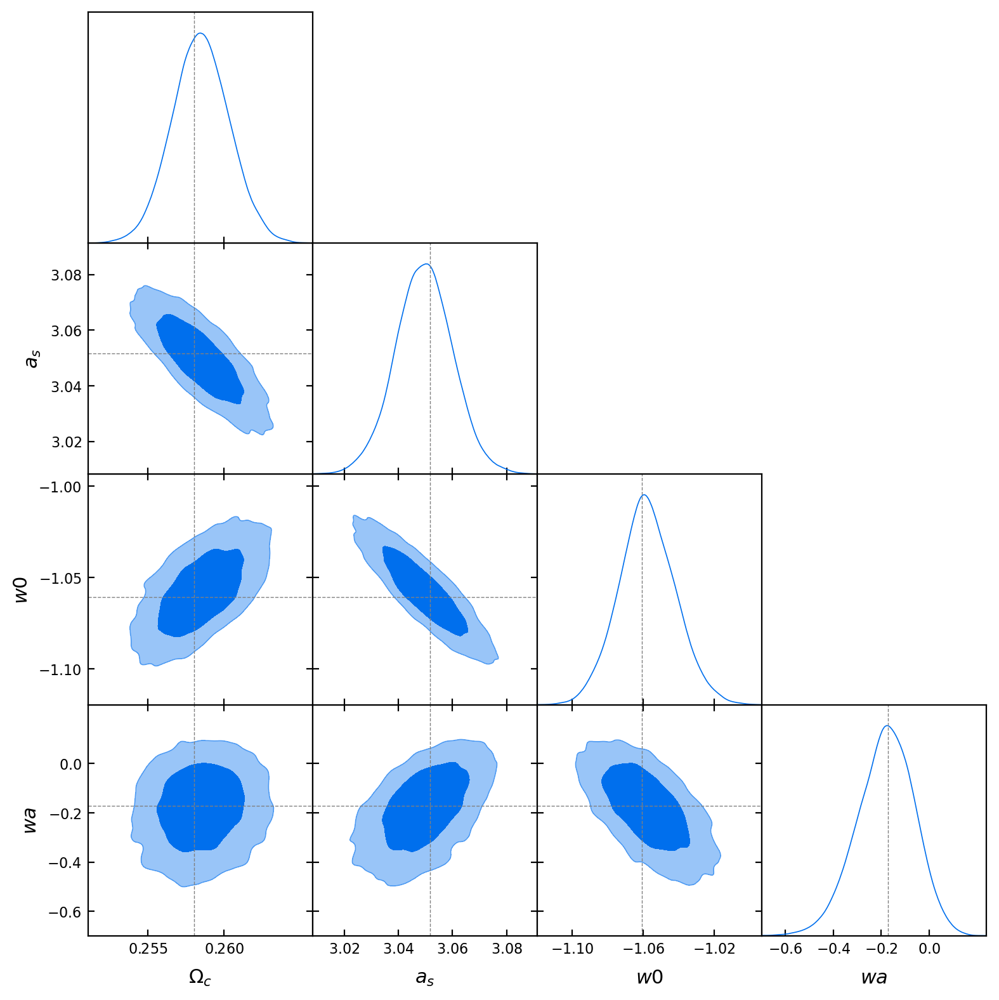

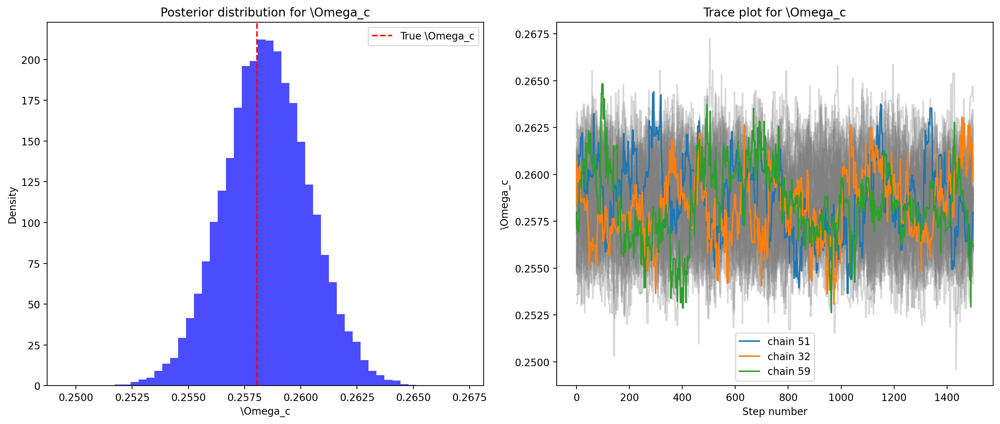

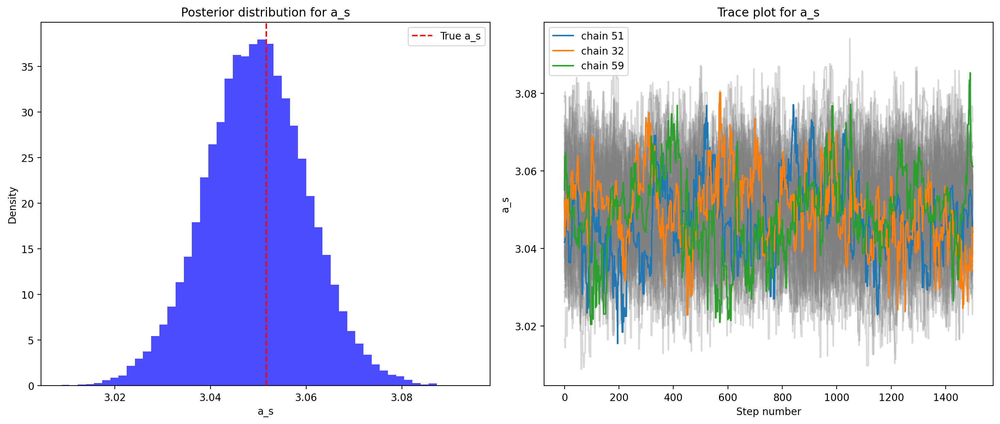

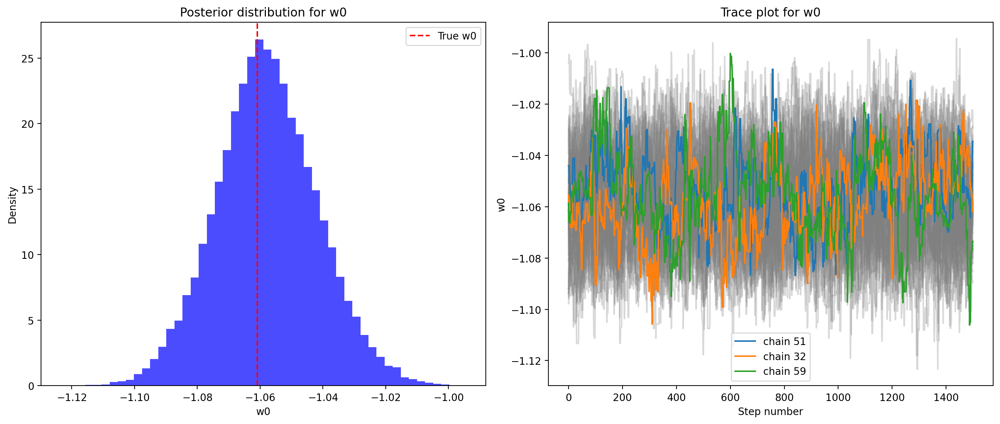

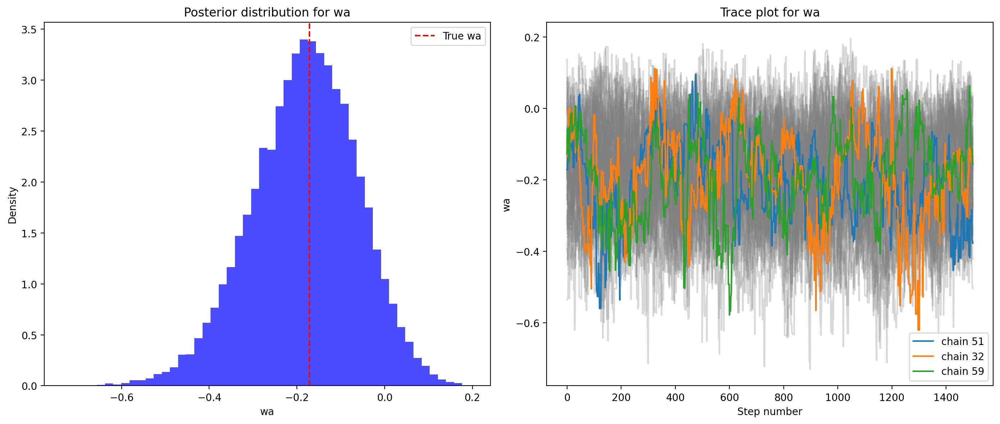

In [36]:
plot_data_4_param_w0_wa("chain_results_4_64_2000_2000_w0_wa_run_1.npy")

In [ ]:
# KL 
# DIC
# BAYES FACTOR

# omega_c, as, m_nu, w0, wa
# jeffrey prior, gaussian, uniform

In [14]:
def plot_data_5_param_w0_wa_m_nu(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "a_s", "m_nu", "w0", "wa"]
    labels = ["\Omega_c", "a_s", "m_nu", "w0", "wa"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters_neutrino_mass_varying_dark_energy.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "a_s": np.log(true_param[4] * 10**10), 
                             "m_nu": true_param[5], 
                             "w0": true_param[6], 
                             "wa": true_param[7]})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-7].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-9])
    ndim = int(file_name.split("_")[-10])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i == 0:
            axs[0].axvline(x=true_param[2], color='red', linestyle='--', label=f"True {label}")
        elif i == 2:
            axs[0].axvline(x=true_param[5], color='red', linestyle='--', label=f"True {label}")
        elif i == 3:
            axs[0].axvline(x=true_param[6], color='red', linestyle='--', label=f"True {label}")
        elif i== 4:
            axs[0].axvline(x=true_param[7], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[4] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


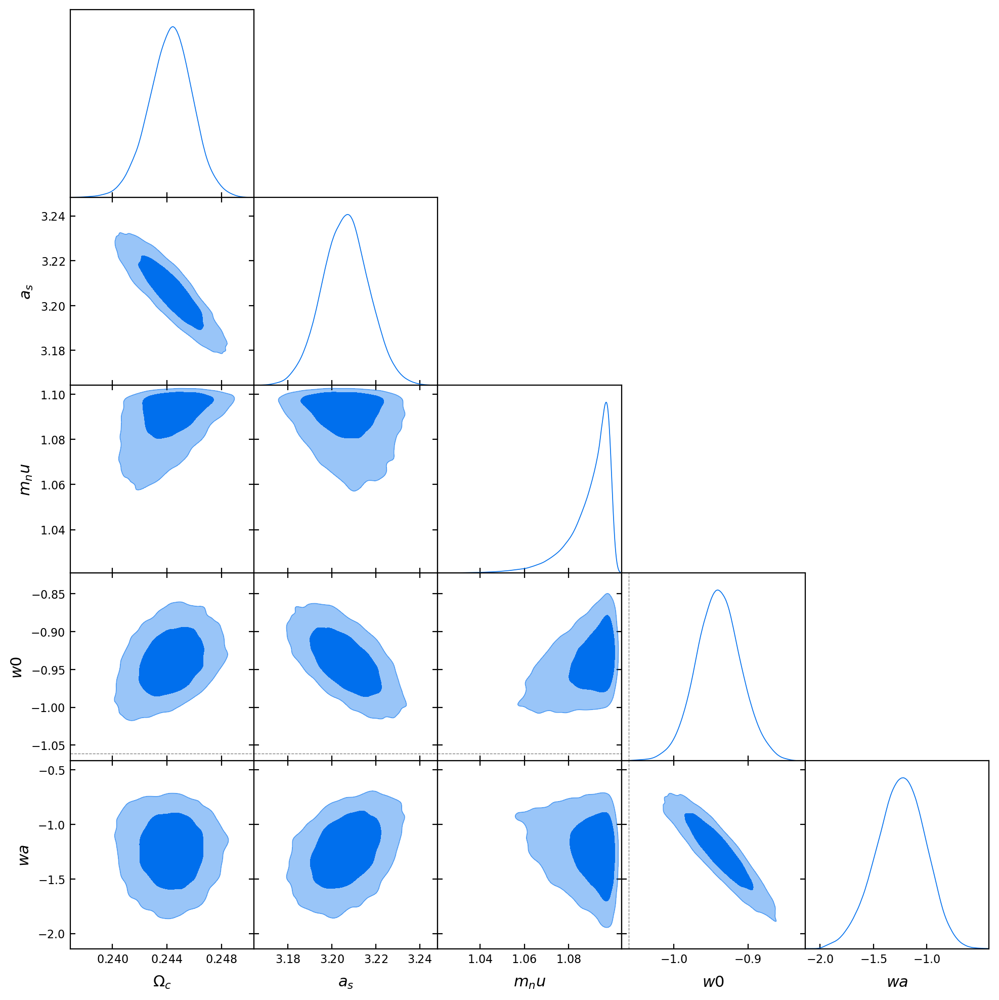

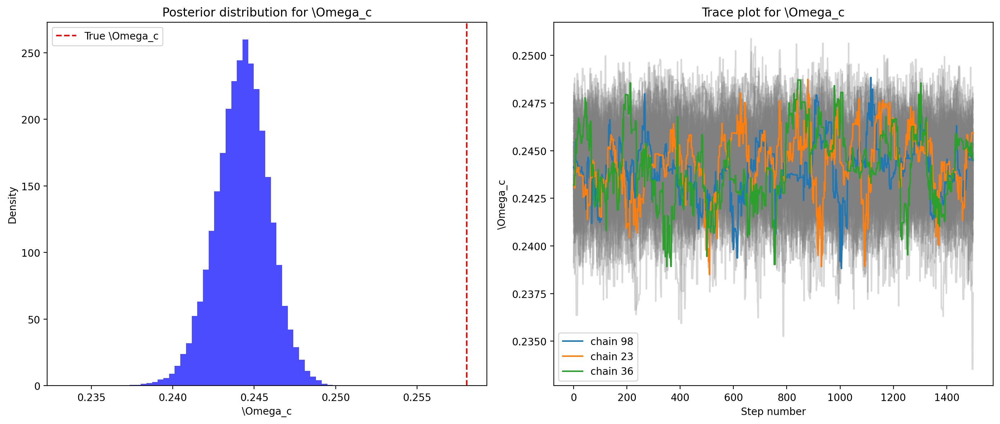

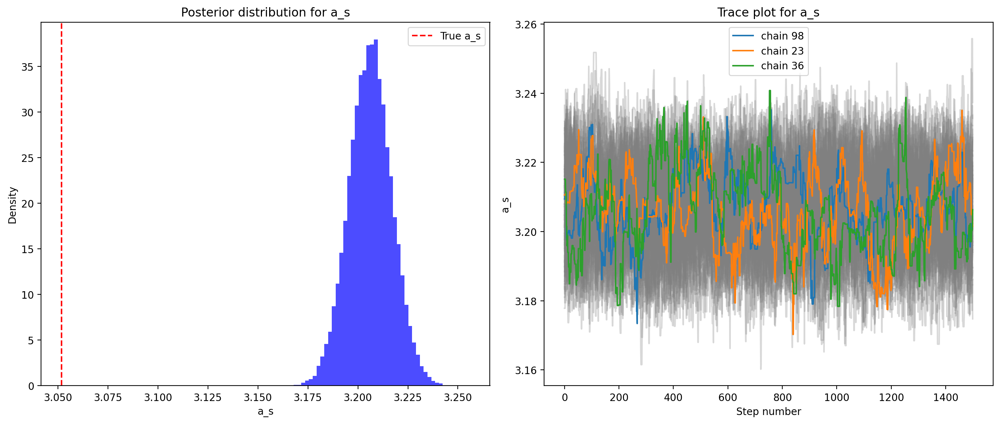

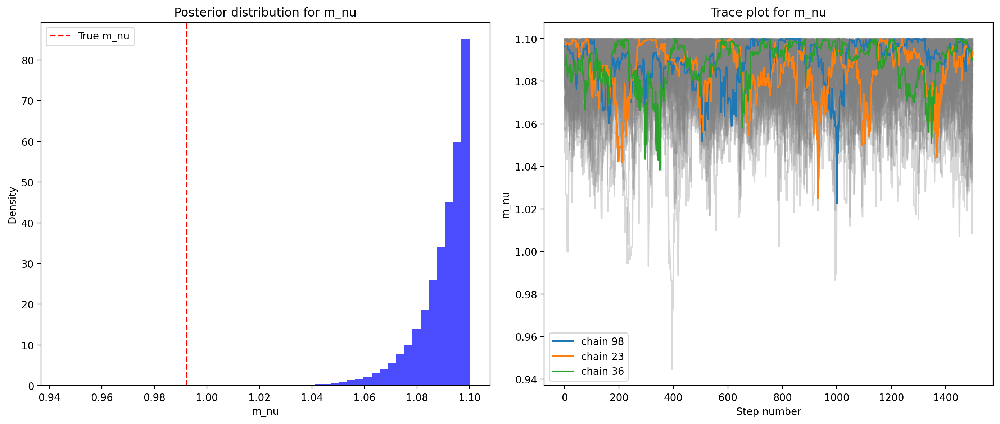

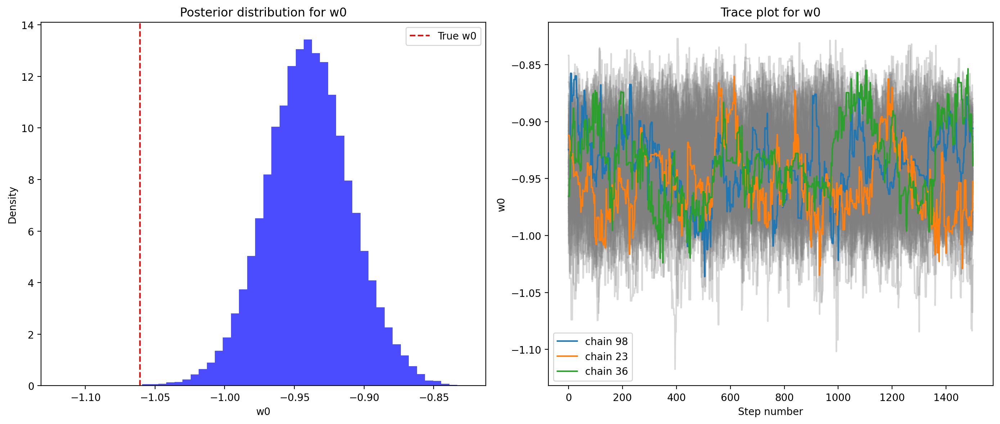

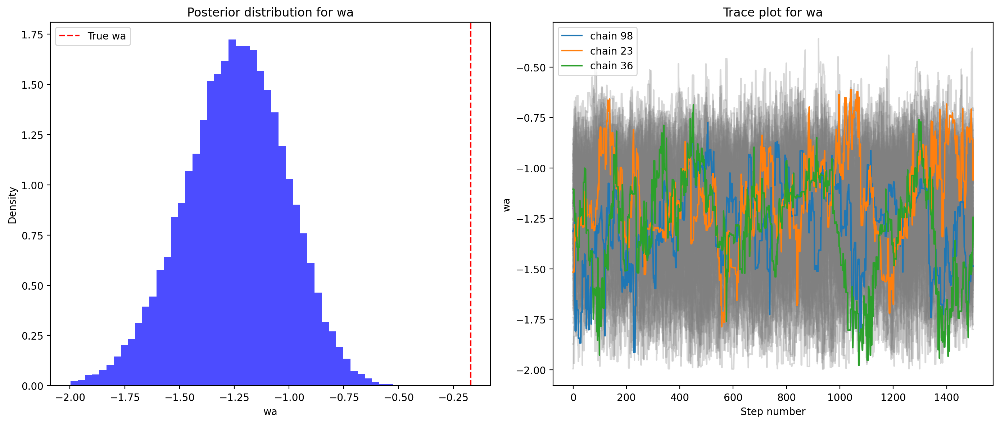

In [15]:
plot_data_5_param_w0_wa_m_nu("chain_results_5_128_2000_2000_m_nu_w0_wa_run_1.npy")

Removed no burn in


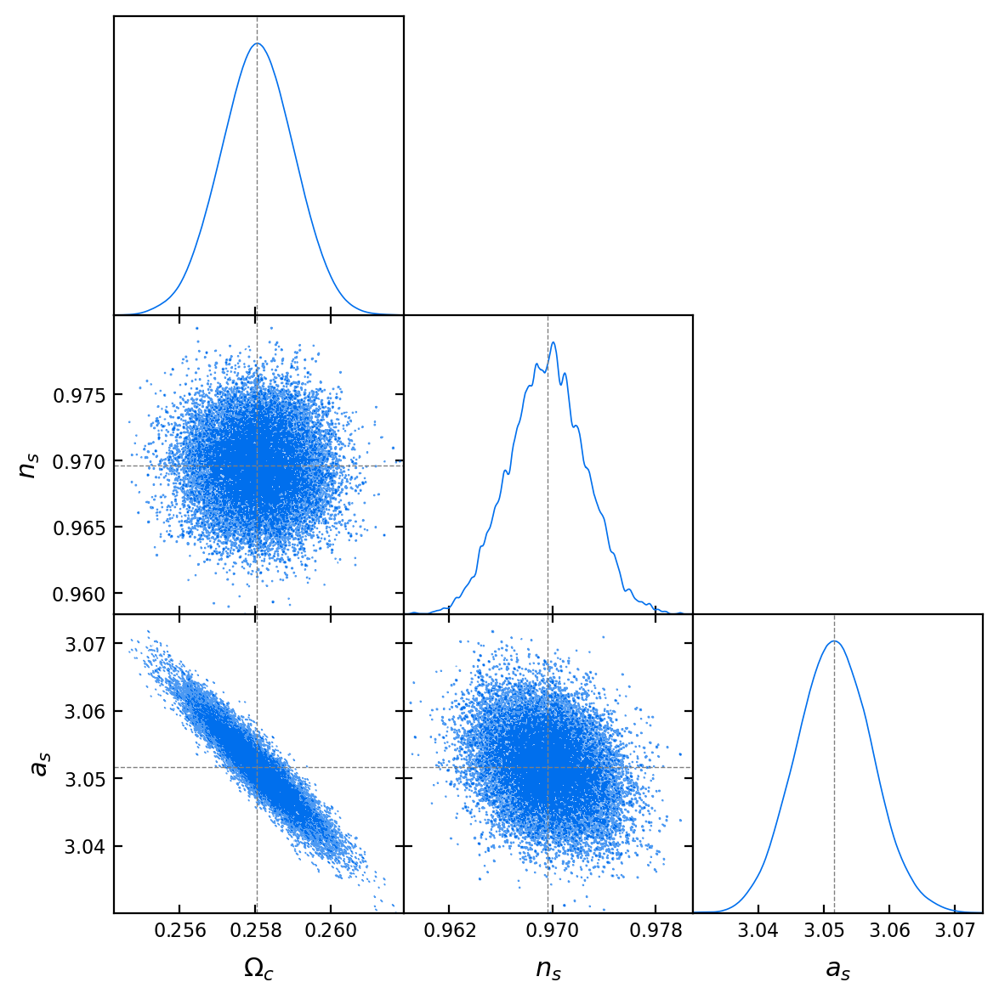

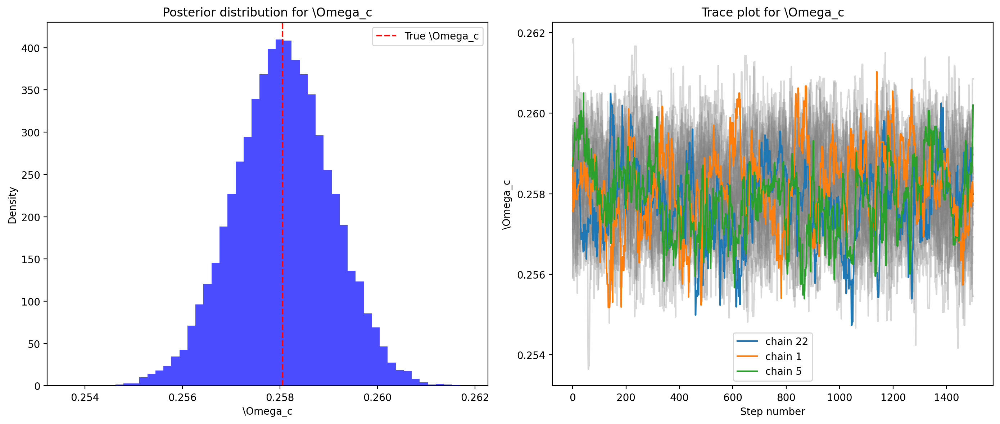

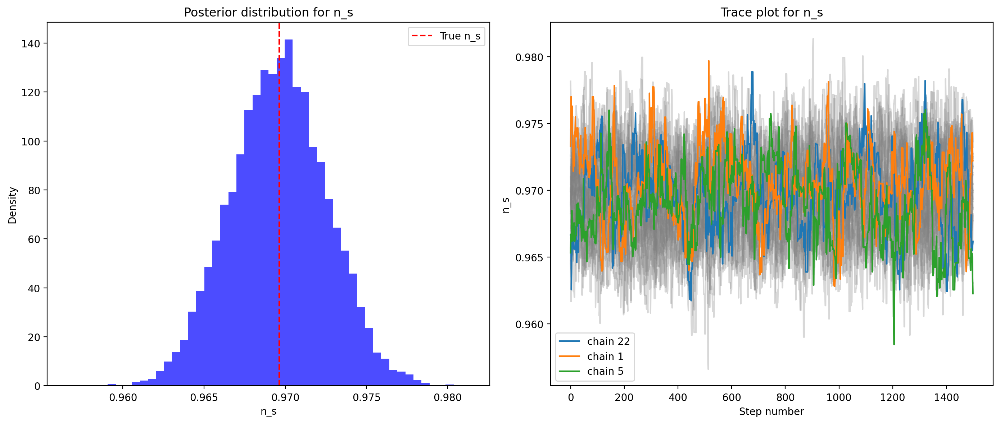

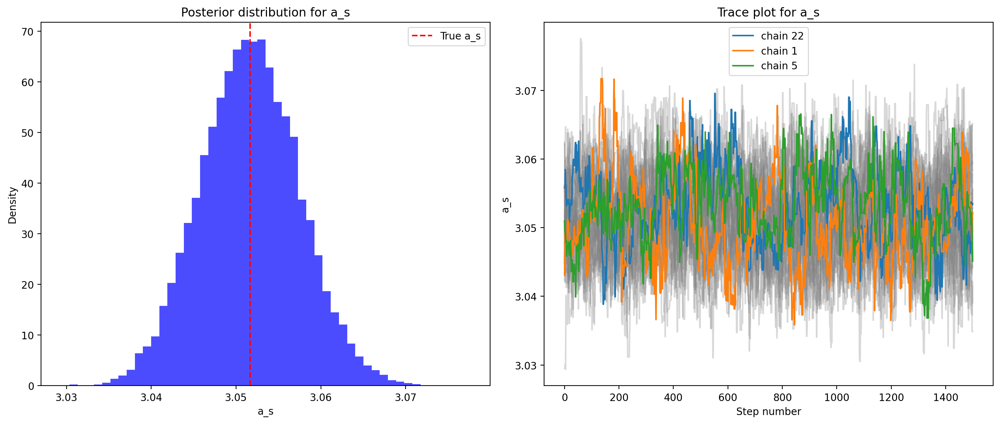

In [16]:
plot_data_3_param("chain_results_3_32_1500_2000_run_1.npy")

In [19]:
def plot_data_4_param_m_nu(file_name):
    # define parameter names and labels
    names = ["\Omega_c", "n_s", "a_s", "m_{nu}"]
    labels = ["\Omega_c", "n_s", "a_s", "m_{nu}"]
    
    # load the MCMC samples
    emcee_sample = MCSamples(samples=np.load(file_name), names=names, labels=labels, 
                             settings={'fine_bins_2D': 2048, 
                                       'fine_bins': 2048,
                                       'smooth_scale_1D': 0.2,
                                       'smooth_scale_2D': 0.2})
    emcee_sample.updateSettings({'contours': [0.68, 0.95, 0.99]})

    # load true parameters
    true_param = np.load("true_parameters_neutrino_mass_n_s.npy")
    
    # plot the triangle plot
    g = plots.get_subplot_plotter()
    g.triangle_plot(emcee_sample, filled=True, 
                    markers={"\Omega_c": true_param[2], 
                             "n_s": true_param[3],
                             "a_s": np.log(true_param[4] * 10**10), 
                             "m_nu": true_param[5]})

    # reshape the chain
    chain_length = (int(file_name.split("_")[-5].split(".")[0]) // 4) * 3
    nwalker = int(file_name.split("_")[-7])
    ndim = int(file_name.split("_")[-8])
    chains = np.load(file_name).reshape(chain_length, nwalker, ndim)
    
    # randomly select three walkers
    option1, option2, option3 = random.sample(range(0, nwalker), 3)

    # plot trace plots and posterior distributions side by side
    for i, label in enumerate(labels):
        fig, axs = plt.subplots(1, 2, figsize=(14, 6))
        
        # trace plot with background chains
        for j in range(nwalker):
            axs[1].plot(np.arange(chain_length), chains[:, j, i], color='gray', alpha=0.3)
        axs[1].plot(np.arange(chain_length), chains[:, option1, i], label=f"chain {option1}")
        axs[1].plot(np.arange(chain_length), chains[:, option2, i], label=f"chain {option2}")
        axs[1].plot(np.arange(chain_length), chains[:, option3, i], label=f"chain {option3}")
        axs[1].set_title(f"Trace plot for {label}")
        axs[1].set_xlabel("Step number")
        axs[1].set_ylabel(label)
        axs[1].legend()

        # posterior distribution plot
        axs[0].hist(chains[:, :, i].flatten(), bins=50, density=True, alpha=0.7, color='blue')
        if i == 0:
            axs[0].axvline(x=true_param[2], color='red', linestyle='--', label=f"True {label}")
        elif i == 3:
            axs[0].axvline(x=true_param[5], color='red', linestyle='--', label=f"True {label}")
        elif i == 1:
            axs[0].axvline(x=true_param[3], color='red', linestyle='--', label=f"True {label}")
        else:
            axs[0].axvline(x=np.log(true_param[4] * 10**10), color='red', linestyle='--', label=f"True {label}")
        axs[0].set_title(f"Posterior distribution for {label}")
        axs[0].set_xlabel(label)
        axs[0].set_ylabel("Density")
        axs[0].legend()

        plt.tight_layout()
        plt.show()

Removed no burn in


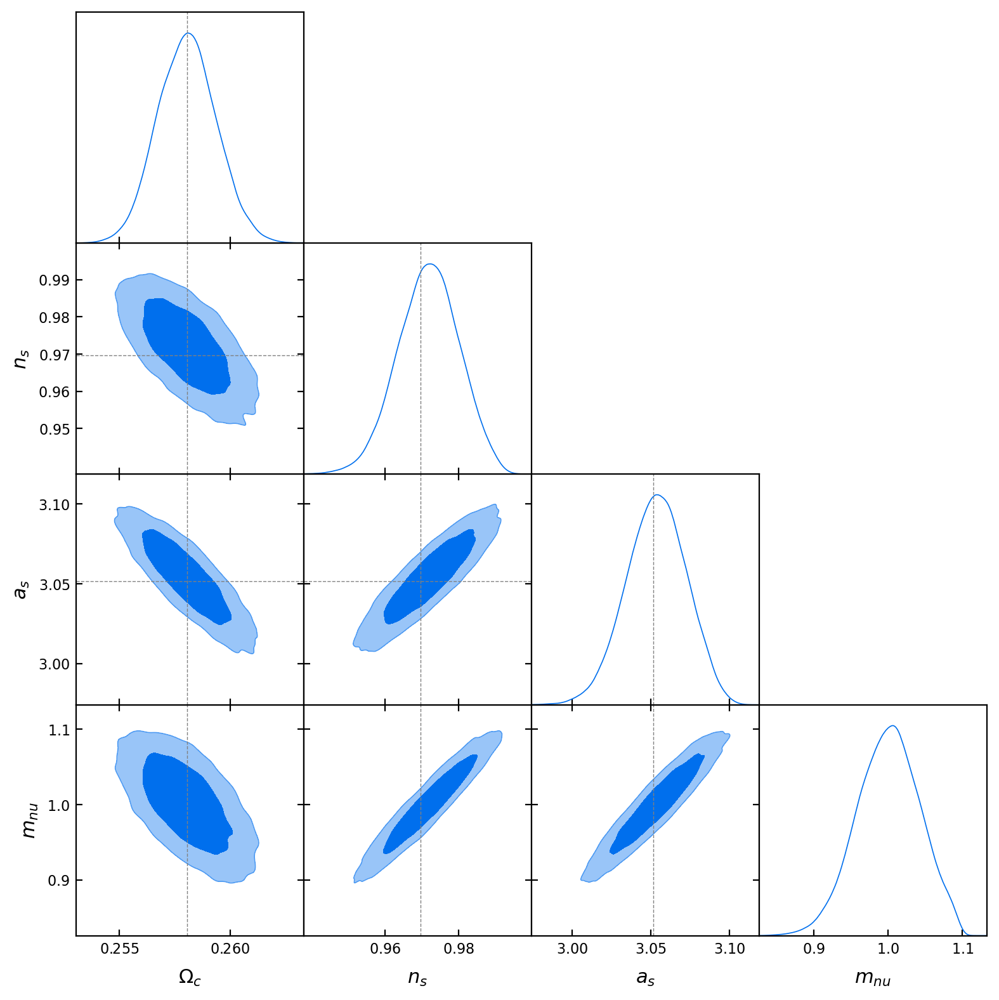

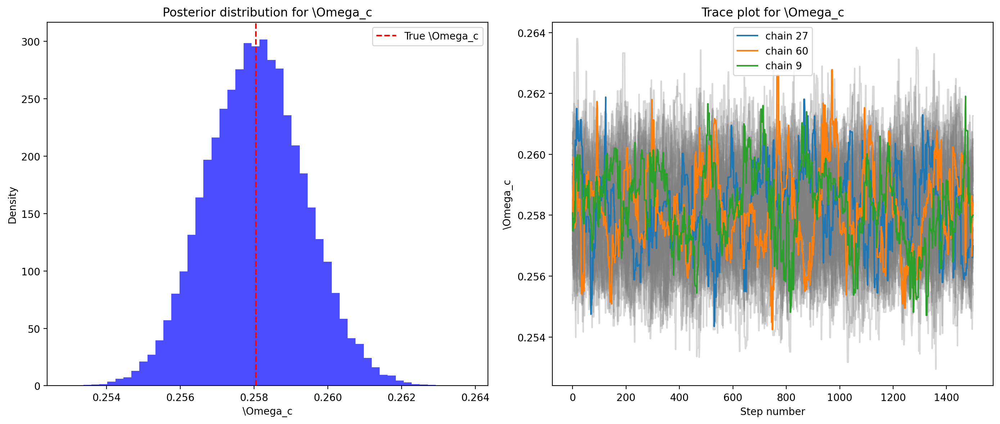

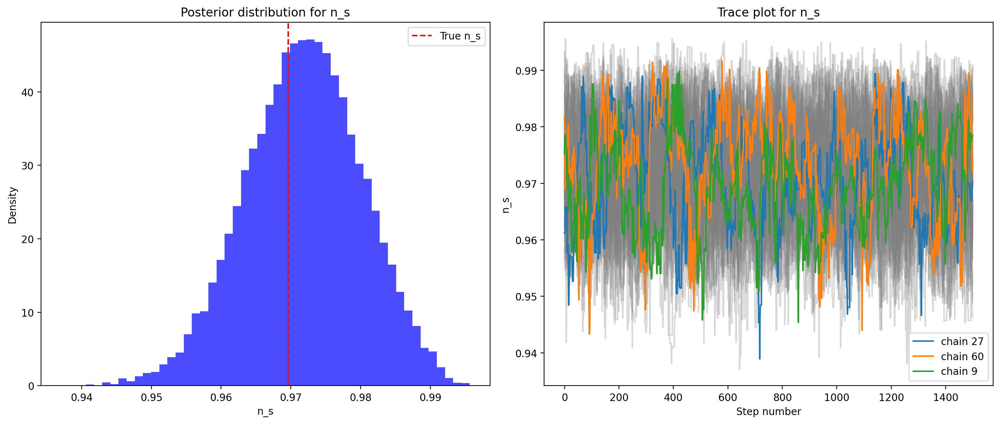

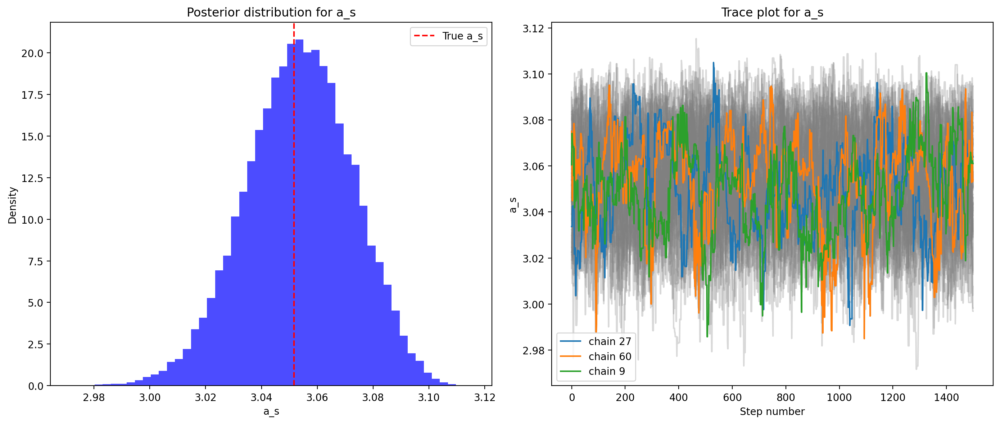

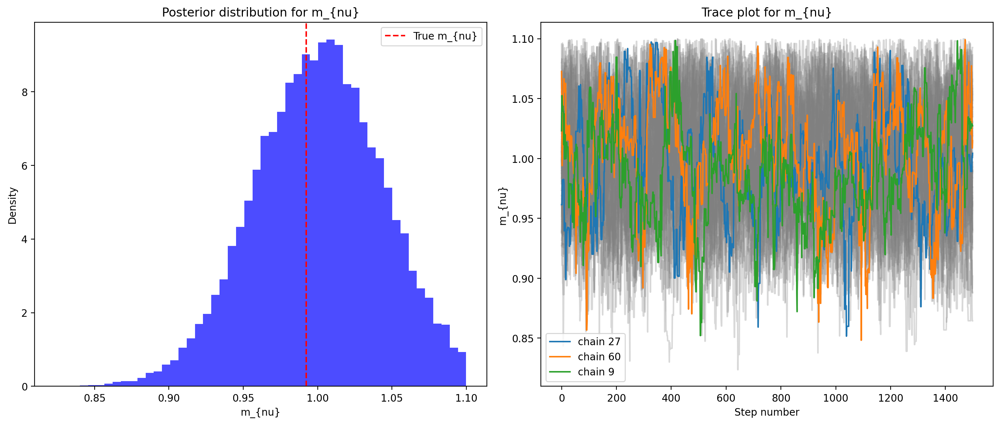

In [20]:
plot_data_4_param_m_nu("chain_results_4_64_2000_2000_m_nu_run_1.npy")

# n_s <-> m_nu

Removed no burn in


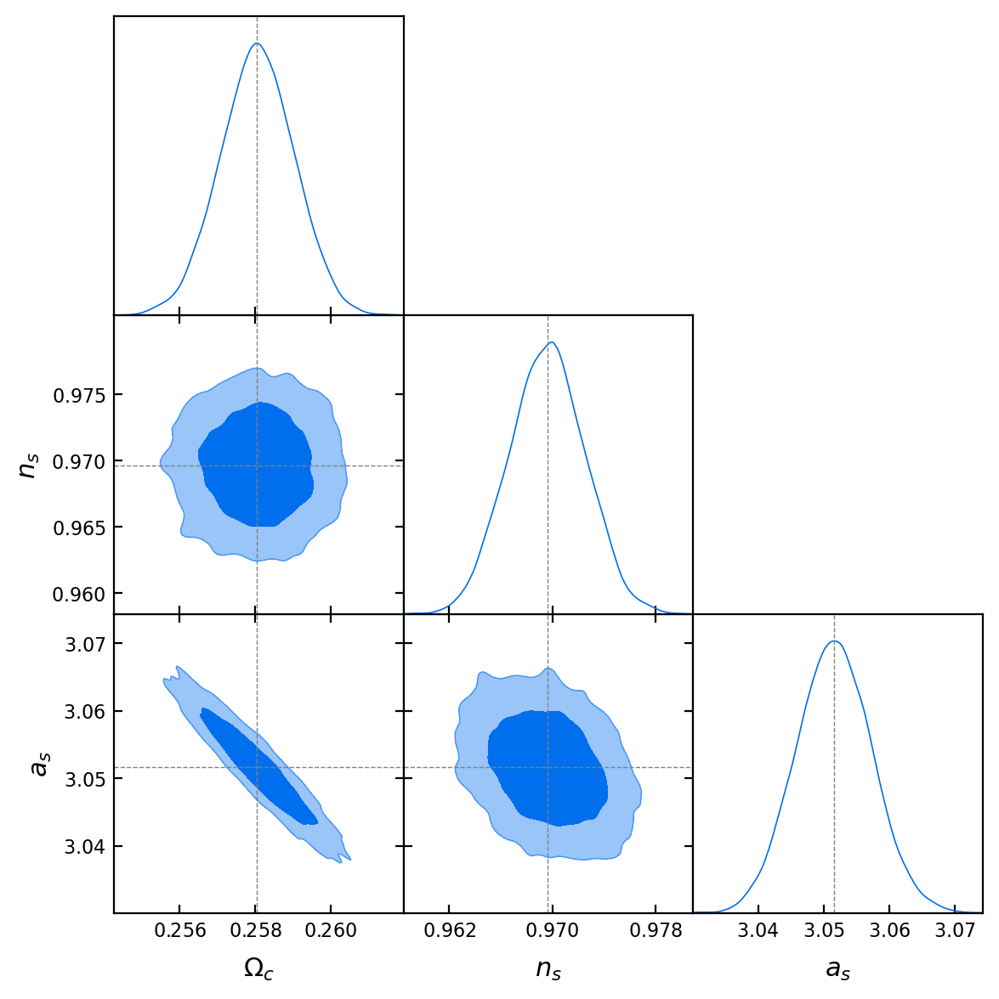

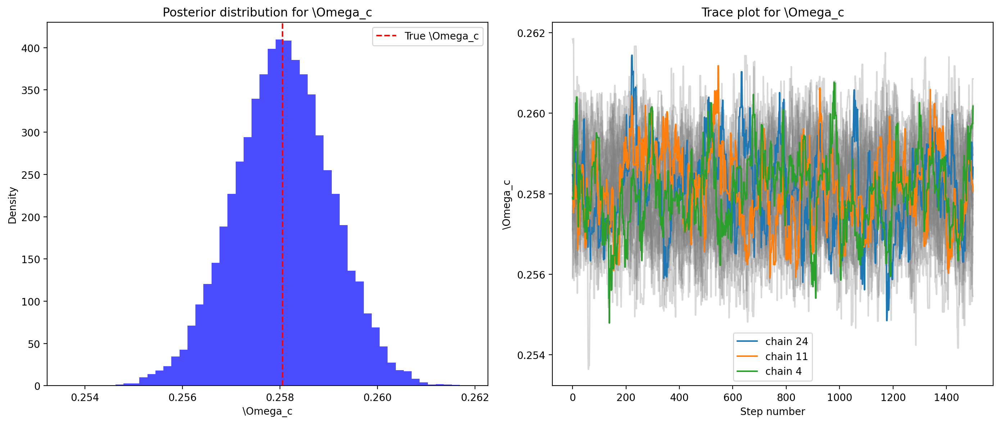

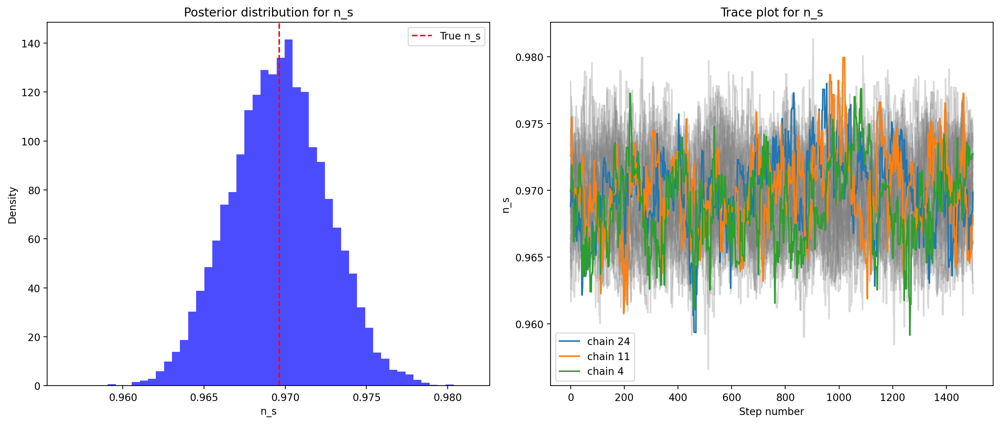

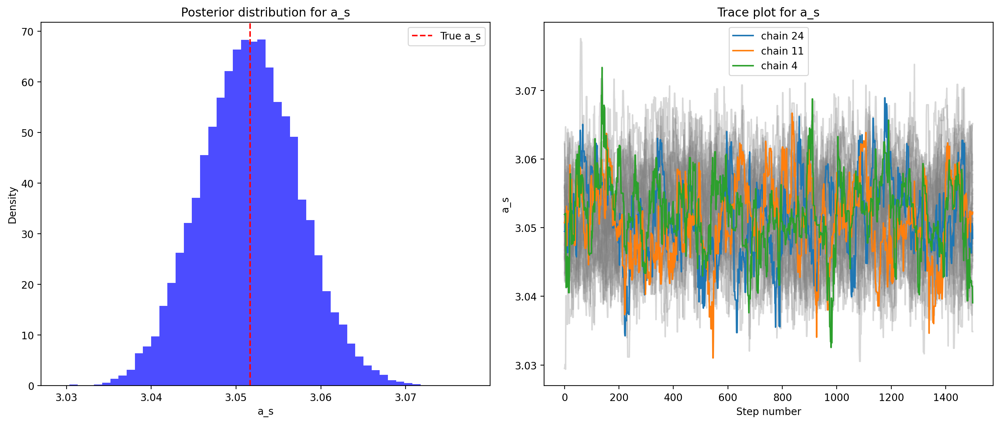

In [29]:
plot_data_3_param("chain_results_3_32_1500_2000_run_1.npy")

Removed no burn in


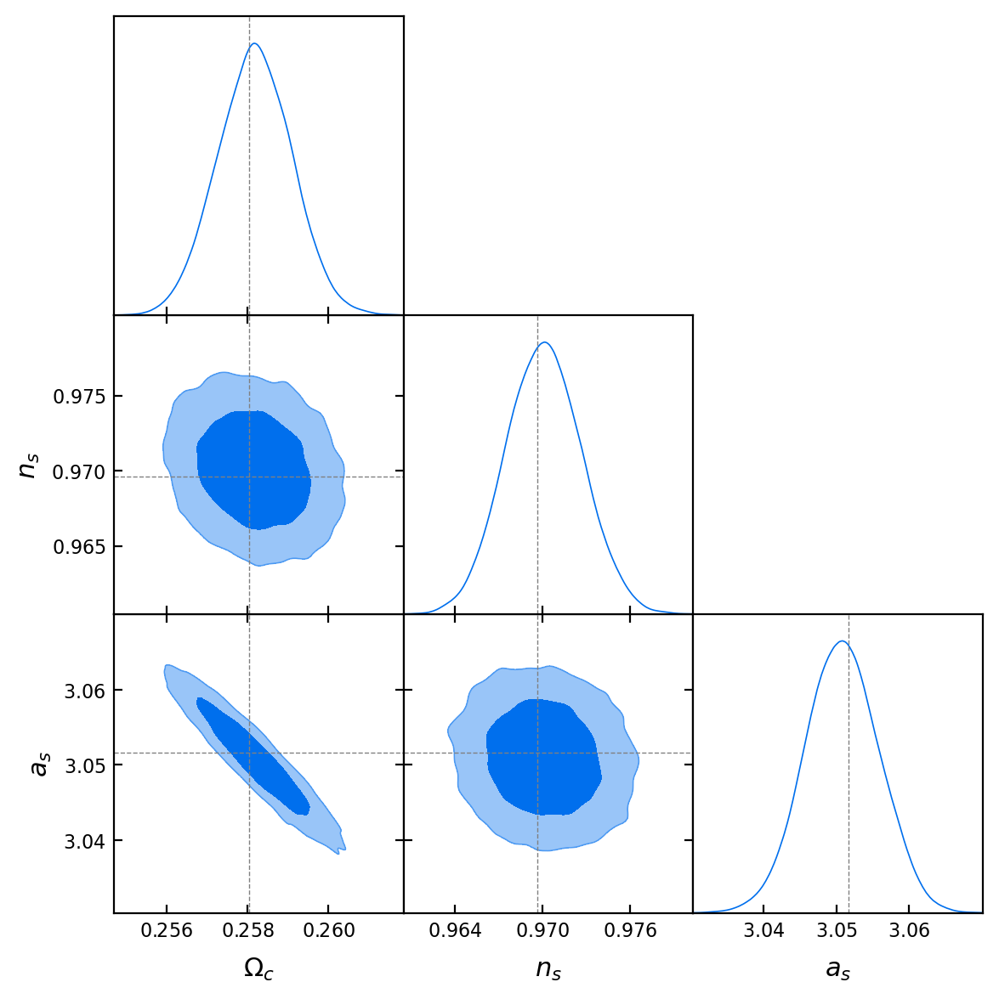

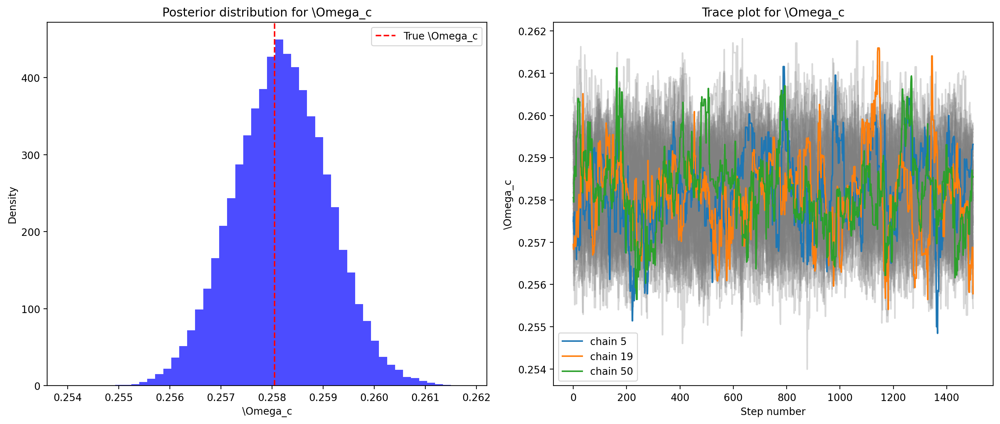

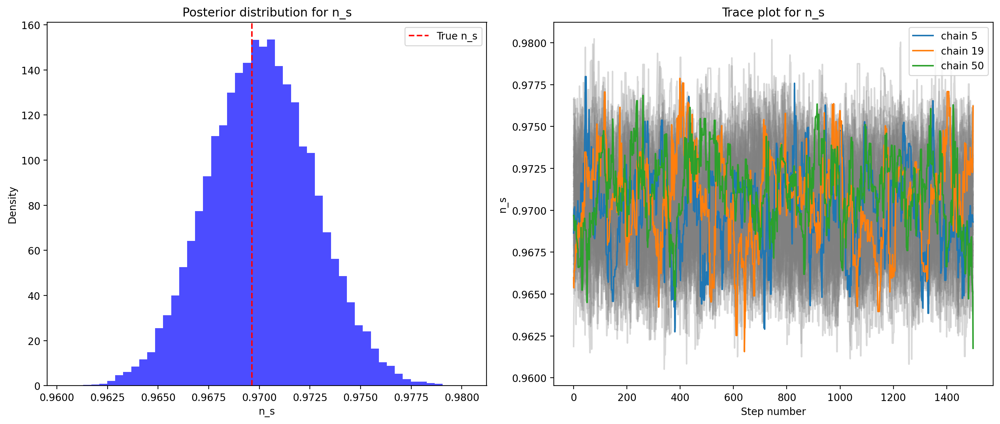

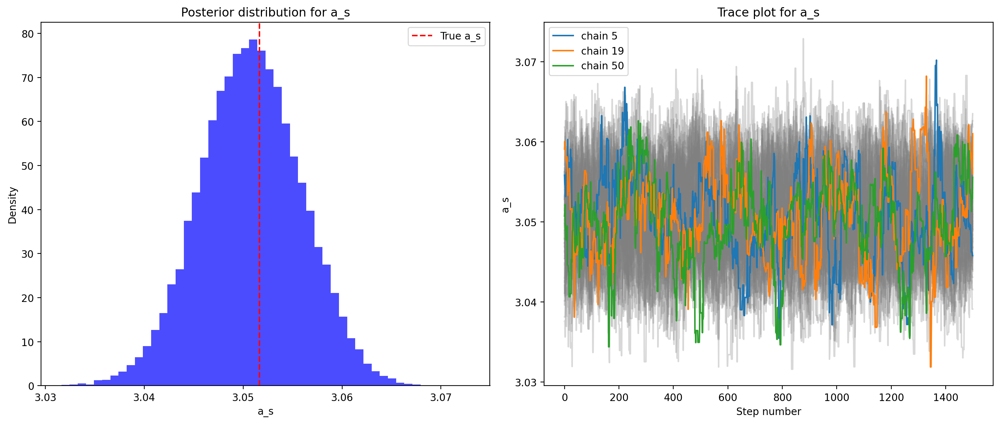

In [28]:
plot_data_3_param("chain_results_3_64_2000_2000_run_1.npy")

Removed no burn in


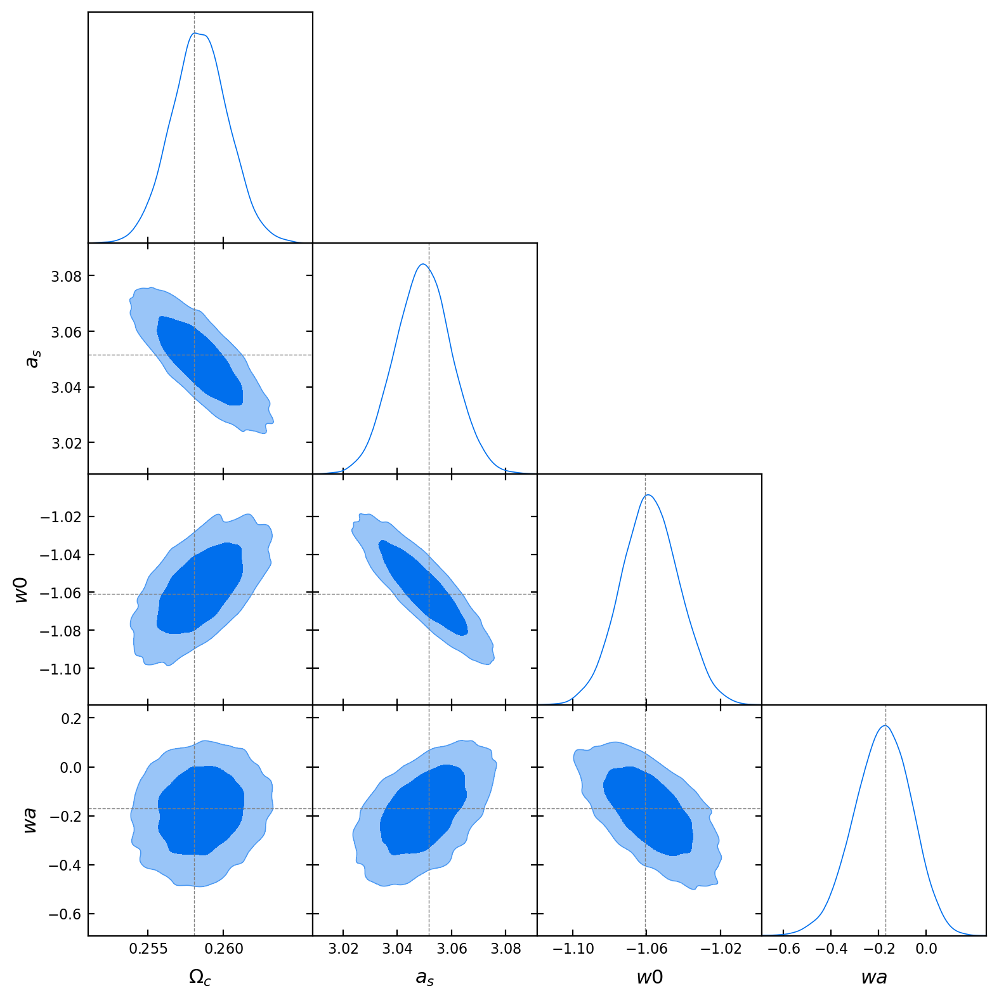

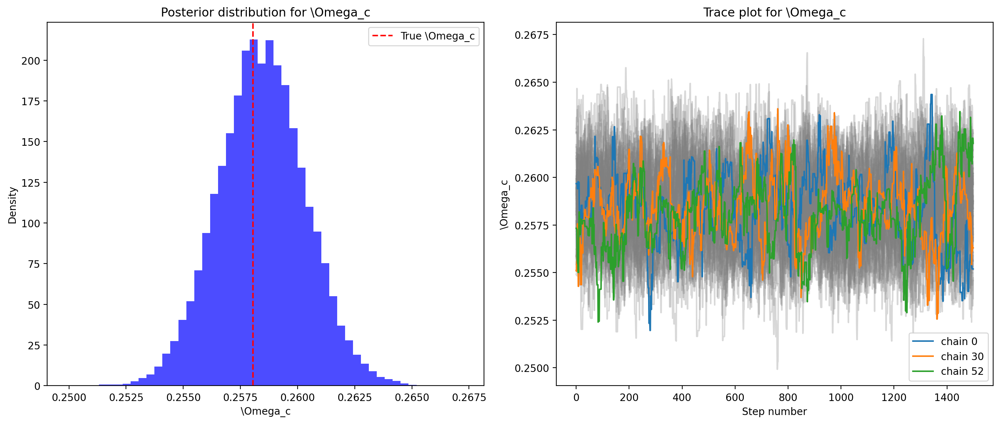

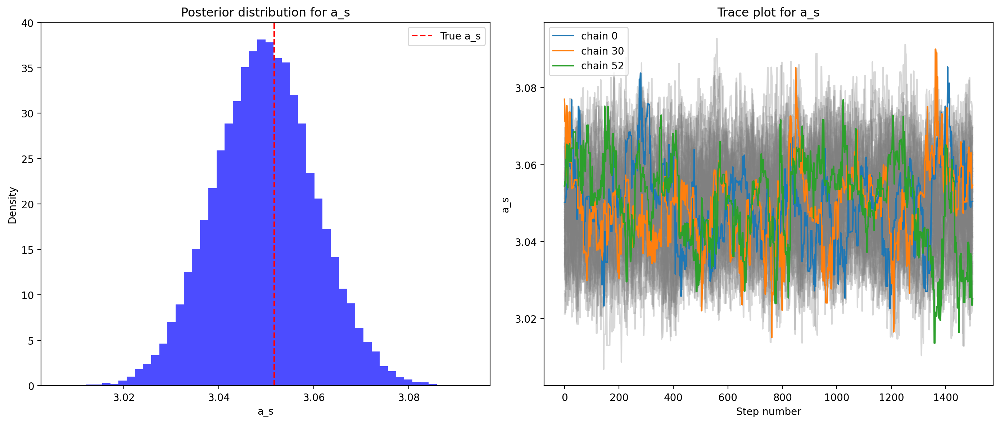

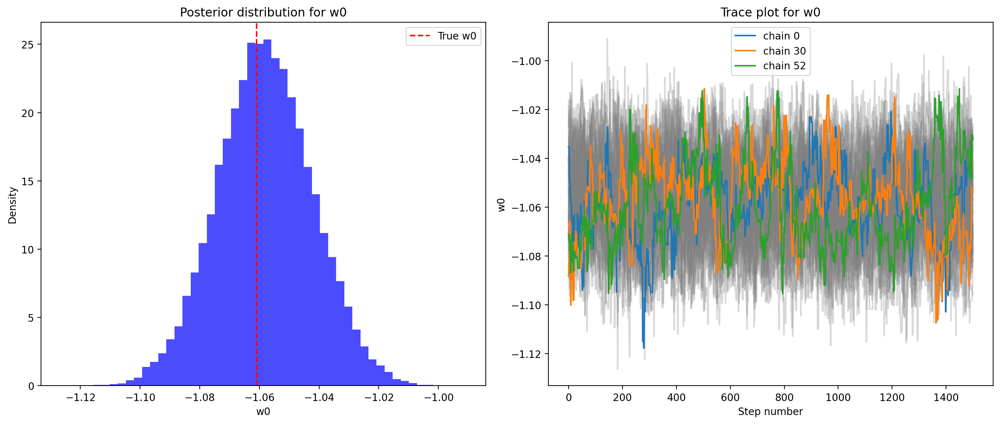

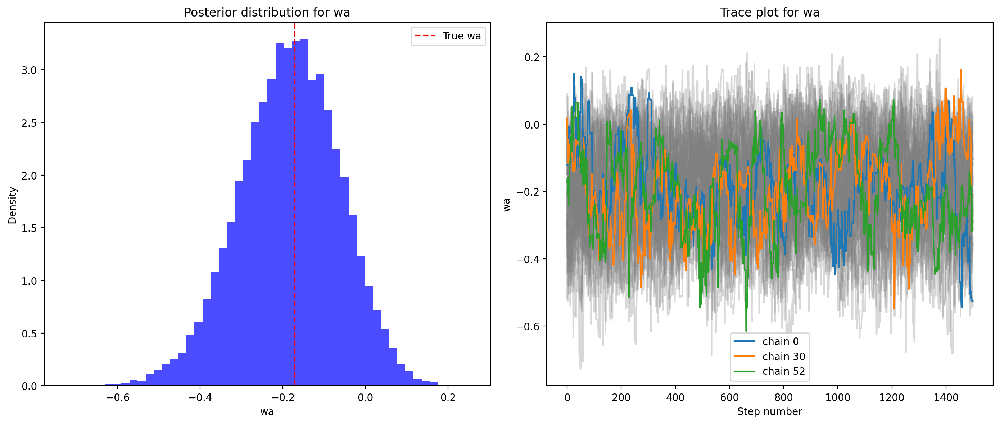

In [33]:
plot_data_4_param_w0_wa("chain_results_4_64_2000_2000_w0_wa_run_2.npy")

Removed no burn in


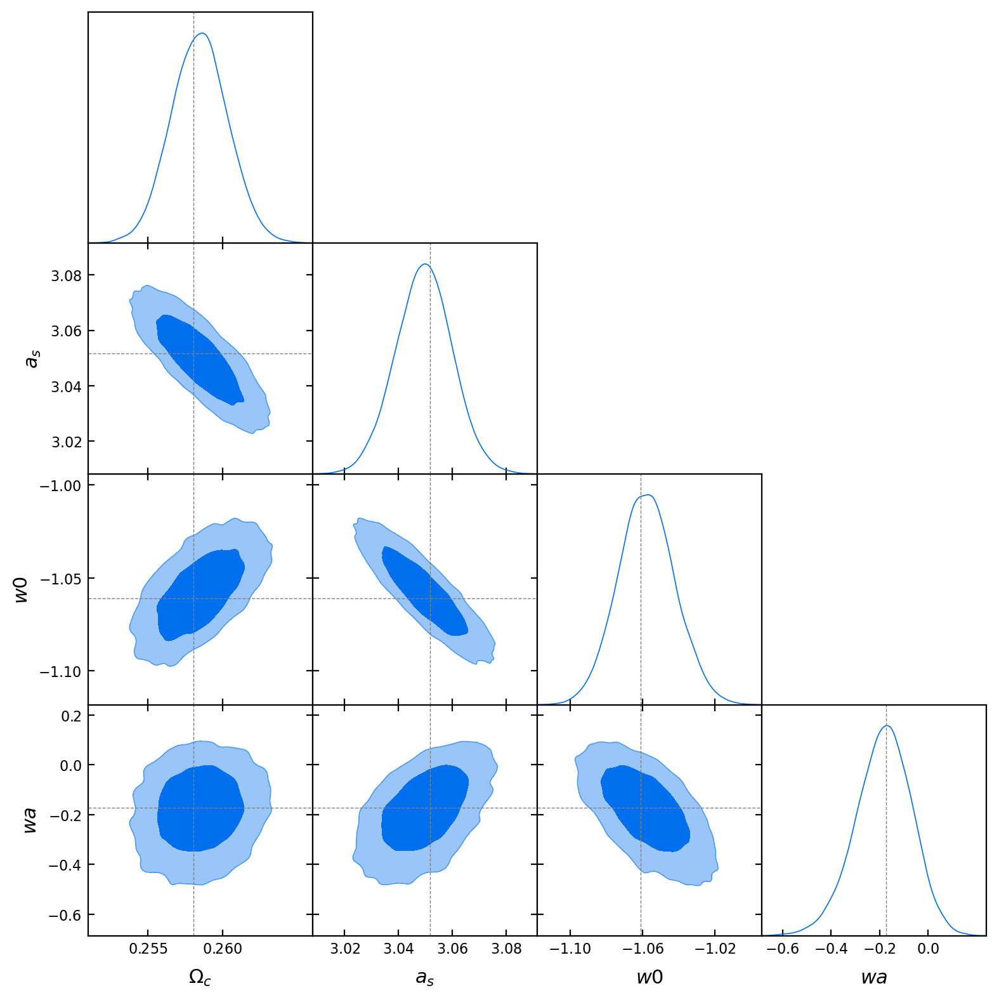

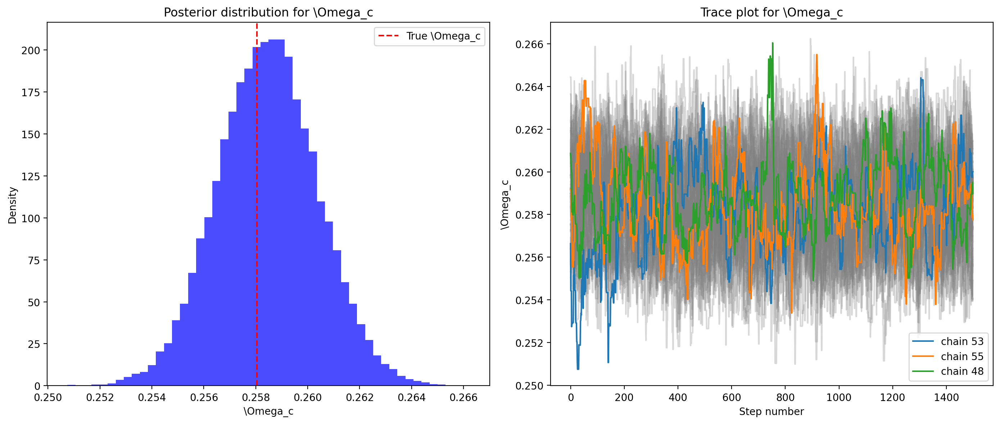

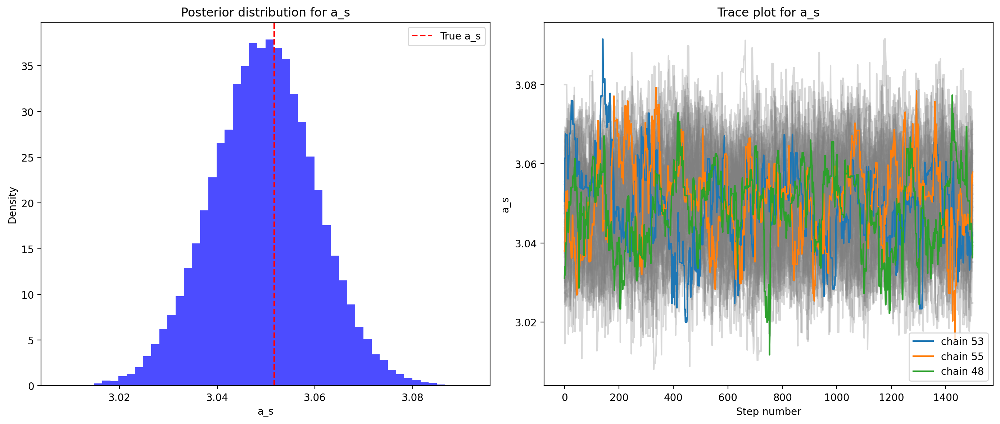

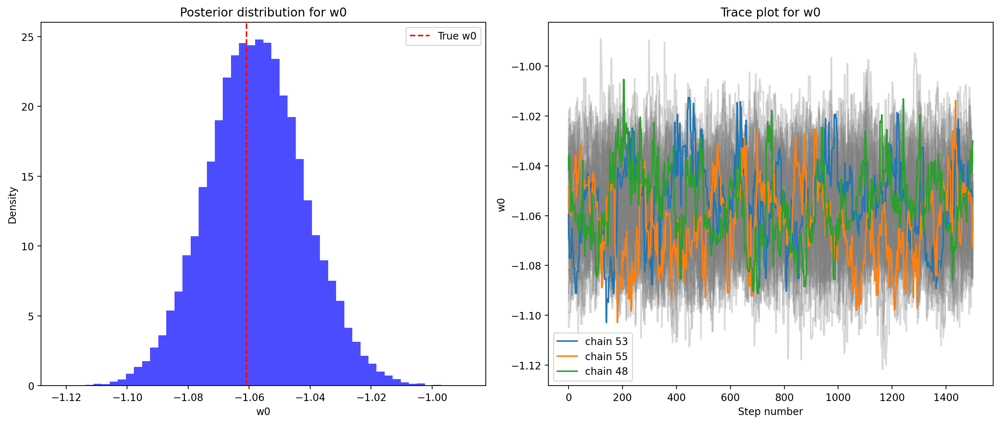

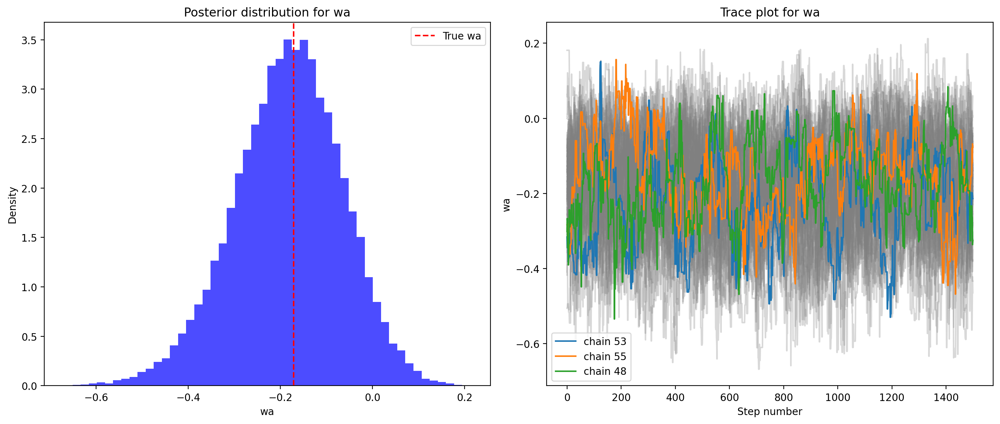

In [34]:
plot_data_4_param_w0_wa("chain_results_4_64_2000_2000_w0_wa_run_3.npy")

Removed no burn in


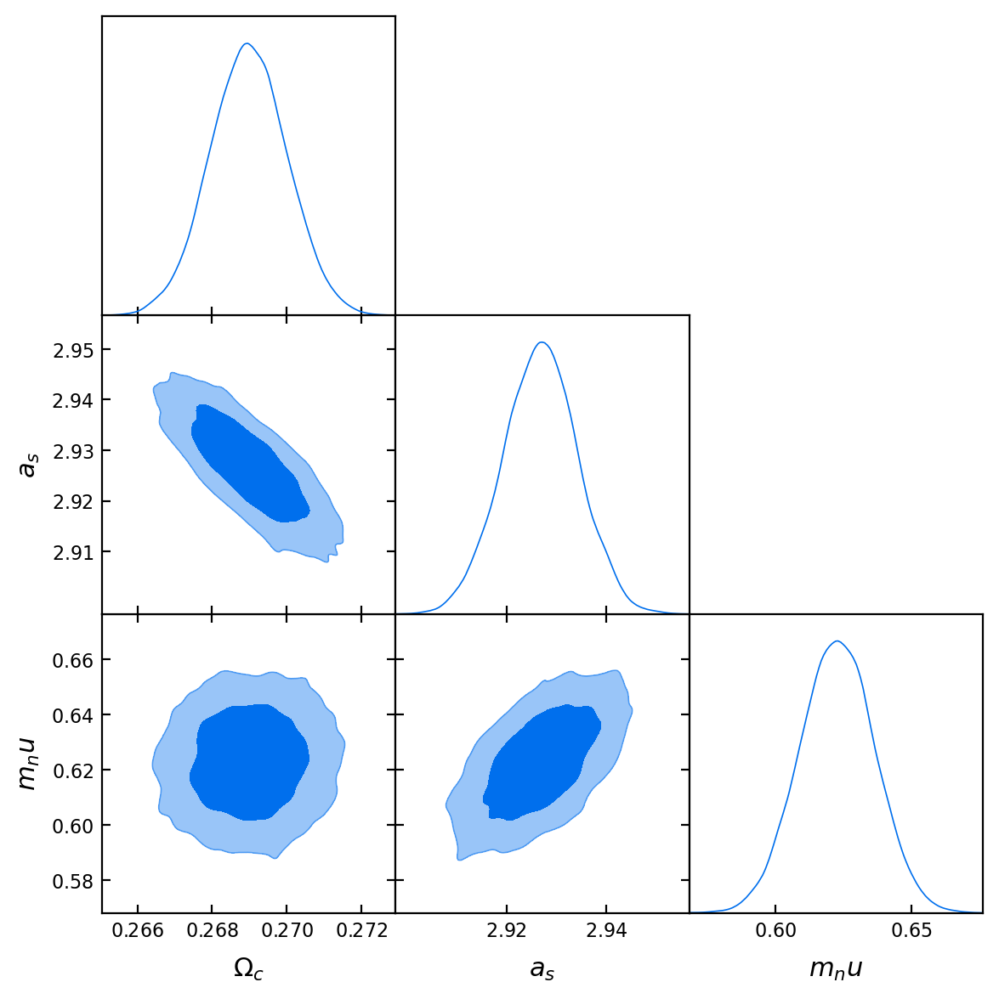

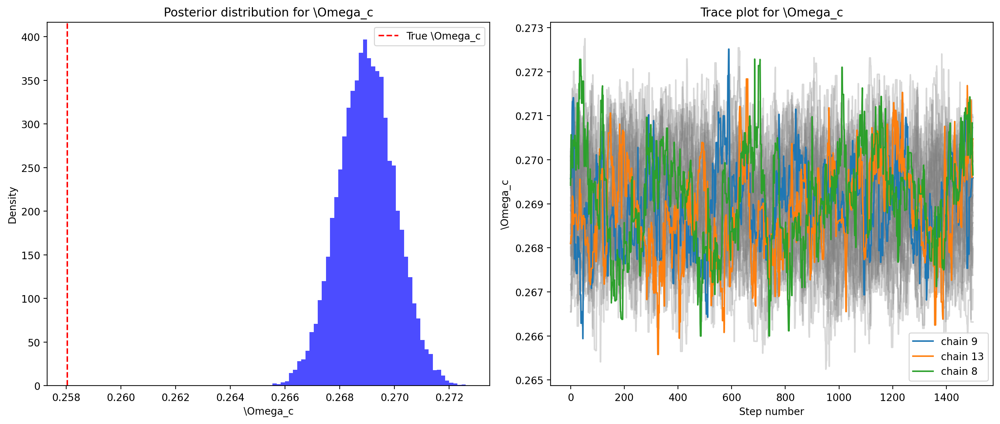

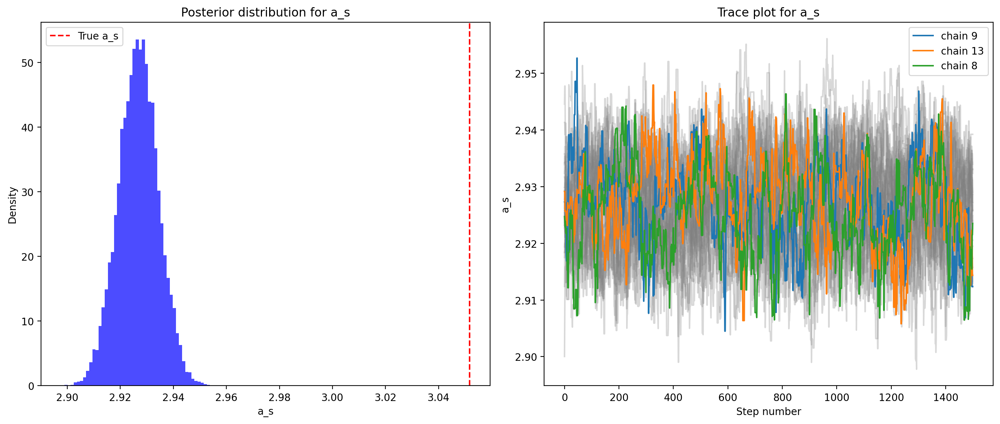

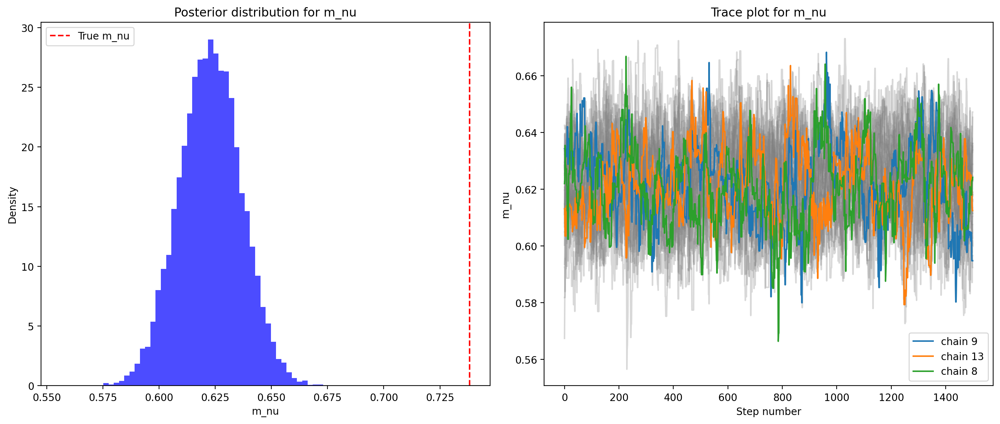

In [39]:
plot_data_3_param_m_nu("chain_results_3_32_1500_2000_m_nu_run_1.npy")